## COGS 185 final project DC-GANs 
This notebook is where I will be doing the experiments on CIFAR10 using DC GANs with two different activations and many different learning rates to get the best results. Along the way, I will be trying my best to have effective logging and visualization in order to show the progress of the results and training better. 

The results that are reported on the paper may not be all shown here because I reran the training cells multiple times using different hyperparameters. However, the code remains the same for each training except for hte hyperparameters. 

Additionally, there were some bugs with the validating methods that I was not able to fix but they didn't hurt the goals of the project. 


In [1]:
import os, random, math, time, json
from pathlib import Path

import torch, torchvision
from torch import nn
from torch.utils.data import DataLoader, random_split
from torchvision import transforms as T, utils, datasets

import matplotlib.pyplot as plt
import numpy as np
from tqdm.auto import tqdm
from IPython.display import clear_output, display

SEED = 42
random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

torch.backends.cuda.matmul.allow_tf32 = True
torch.backends.cudnn.benchmark = True

device = (
    torch.device("cuda") if torch.cuda.is_available()
    else torch.device("mps") if torch.backends.mps.is_available()
    else torch.device("cpu")
)

print(f"Using device: {device}")

Using device: cuda


In [10]:
cfg = {

    "image_size": 64,
    "batch_size": 128,

    "nz": 128,
    "ngf": 128,
    "ndf": 128,

    "epochs": 50,
    "lr_g": 0.0002,
    "lr_d": 0.0002,x
    "beta1": 0.5,
    "beta2": 0.999,


    "label_smooth": 0.1,
    "inst_noise": 0.05,
    "noise_fade": 15,

    "sample_every": 5,
    "save_every": 20,
    "sample_dir": "samples",
    "ckpt_dir": "checkpoints"
}

Path(cfg["sample_dir"]).mkdir(exist_ok=True)
Path(cfg["ckpt_dir"]).mkdir(exist_ok=True)

print("Configuration:")
for k, v in cfg.items():
    print(f"  {k}: {v}")

Configuration:
  image_size: 64
  batch_size: 128
  nz: 128
  ngf: 128
  ndf: 128
  epochs: 50
  lr_g: 0.0002
  lr_d: 0.0002
  beta1: 0.5
  beta2: 0.999
  label_smooth: 0.1
  inst_noise: 0.05
  noise_fade: 15
  sample_every: 5
  save_every: 20
  sample_dir: samples
  ckpt_dir: checkpoints


100%|██████████| 170M/170M [00:02<00:00, 74.9MB/s]


Dataset splits - Train: 45000, Val: 5000


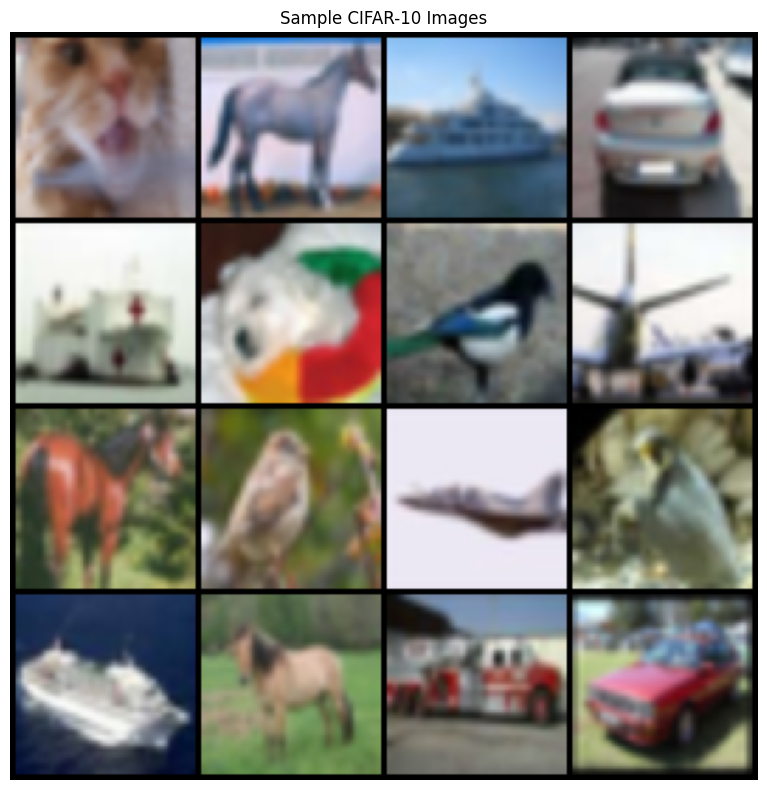

In [3]:
# pre process and check 
transform = T.Compose([
    T.Resize(cfg["image_size"]),
    T.RandomHorizontalFlip(p=0.5),
    T.ToTensor(),
    T.Normalize([0.5]*3, [0.5]*3),
])

dataset = datasets.CIFAR10(root="data", train=True, download=True, transform=transform)

train_len = int(0.9 * len(dataset))
val_len = len(dataset) - train_len
train_set, val_set = random_split(dataset, [train_len, val_len])

train_loader = DataLoader(
    train_set,
    batch_size=cfg["batch_size"],
    shuffle=True,
    num_workers=0,
    pin_memory=True,
    drop_last=True
)

val_loader = DataLoader(
    val_set,
    batch_size=cfg["batch_size"],
    shuffle=False,
    num_workers=0,
    pin_memory=True
)

print(f"Dataset splits - Train: {len(train_set)}, Val: {len(val_set)}")

sample_batch = next(iter(train_loader))[0][:16]
grid = utils.make_grid(sample_batch, nrow=4, padding=2, normalize=True)
plt.figure(figsize=(8, 8))
plt.imshow(grid.permute(1, 2, 0))
plt.title("Sample CIFAR-10 Images")
plt.axis('off')
plt.tight_layout()
plt.savefig(f"{cfg['sample_dir']}/cifar10_samples.png", dpi=150, bbox_inches='tight')
plt.show()

In [4]:
def weights_init(m):
    """Initialize weights according to DCGAN paper"""
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight, 0.0, 0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight, 1.0, 0.02)
        nn.init.zeros_(m.bias)

def spectral_norm_conv(in_c, out_c, k=4, s=2, p=1):
    """Convolution with spectral normalization"""
    return nn.utils.spectral_norm(nn.Conv2d(in_c, out_c, k, s, p, bias=False))

class Generator(nn.Module):
    def __init__(self, nz=128, ngf=128):
        super().__init__()
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),

            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        return self.main(z)

class Discriminator(nn.Module):
    def __init__(self, ndf=128):
        super().__init__()
        self.main = nn.Sequential(
            spectral_norm_conv(3, ndf, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            spectral_norm_conv(ndf, ndf*2, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            spectral_norm_conv(ndf*2, ndf*4, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            spectral_norm_conv(ndf*4, ndf*8, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),
            spectral_norm_conv(ndf*8, 1, 4, 1, 0),
        )

    def forward(self, x):
        return self.main(x).view(-1)

G = Generator(cfg["nz"], cfg["ngf"]).to(device)
D = Discriminator(cfg["ndf"]).to(device)

G.apply(weights_init)
D.apply(weights_init)

print(f"Generator parameters: {sum(p.numel() for p in G.parameters()):,}")
print(f"Discriminator parameters: {sum(p.numel() for p in D.parameters()):,}")

Generator parameters: 13,117,184
Discriminator parameters: 11,032,576


In [5]:
from torch.amp import autocast, GradScaler

criterion = nn.BCEWithLogitsLoss()

opt_G = torch.optim.Adam(G.parameters(), lr=cfg["lr_g"], betas=(cfg["beta1"], cfg["beta2"]))
opt_D = torch.optim.Adam(D.parameters(), lr=cfg["lr_d"], betas=(cfg["beta1"], cfg["beta2"]))

scaler_G = GradScaler('cuda')
scaler_D = GradScaler('cuda')

class EMA:
    def __init__(self, model, decay=0.999):
        self.model = model
        self.decay = decay
        self.shadow = {}
        self.backup = {}

        for name, param in model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.data.clone()

    def update(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = self.decay * self.shadow[name] + (1 - self.decay) * param.data

    def apply_shadow(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.backup[name] = param.data.clone()
                param.data = self.shadow[name]

    def restore(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                param.data = self.backup[name]

ema_G = EMA(G, decay=0.999)

fixed_noise = torch.randn(64, cfg["nz"], 1, 1, device=device)


In [6]:
def add_instance_noise(x, noise_std):
    """Add instance noise to inputs"""
    if noise_std > 0:
        noise = torch.randn_like(x) * noise_std
        return torch.clamp(x + noise, -1, 1)
    return x

def train_epoch(epoch):
    """Train for one epoch"""
    G.train()
    D.train()

    running_G_loss = 0.0
    running_D_loss = 0.0

    current_noise = cfg["inst_noise"] * max(0, 1 - epoch / cfg["noise_fade"])
    smooth_real = 1.0 - cfg["label_smooth"]

    for real_batch, _ in tqdm(train_loader, desc=f"Epoch {epoch}", leave=False):
        batch_size = real_batch.size(0)
        real_batch = real_batch.to(device)

        real_labels = torch.full((batch_size,), smooth_real, device=device)
        fake_labels = torch.zeros(batch_size, device=device)



        opt_D.zero_grad()

        with autocast('cuda'):

            real_noisy = add_instance_noise(real_batch, current_noise)
            d_real = D(real_noisy)
            loss_d_real = criterion(d_real, real_labels)

            z = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
            fake_batch = G(z).detach()
            fake_noisy = add_instance_noise(fake_batch, current_noise)
            d_fake = D(fake_noisy)
            loss_d_fake = criterion(d_fake, fake_labels)

            loss_d = loss_d_real + loss_d_fake

        scaler_D.scale(loss_d).backward()
        scaler_D.step(opt_D)
        scaler_D.update()


        opt_G.zero_grad()

        with autocast('cuda'):
            z = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
            fake_batch = G(z)
            d_fake = D(fake_batch)
            loss_g = criterion(d_fake, real_labels)

        scaler_G.scale(loss_g).backward()
        scaler_G.step(opt_G)
        scaler_G.update()


        ema_G.update()

        running_G_loss += loss_g.item()
        running_D_loss += loss_d.item()

    return running_G_loss / len(train_loader), running_D_loss / len(train_loader)

def save_samples(epoch, filename_suffix=""):
    """Generate and save sample images"""
    ema_G.apply_shadow()
    G.eval()

    with torch.no_grad():
        fake_samples = G(fixed_noise)
        grid = utils.make_grid(fake_samples, nrow=8, padding=2, normalize=True)

        filename = f"{cfg['sample_dir']}/epoch_{epoch:03d}{filename_suffix}.png"
        utils.save_image(grid, filename)

        plt.figure(figsize=(10, 10))
        plt.imshow(grid.cpu().permute(1, 2, 0))
        plt.title(f"Generated Samples - Epoch {epoch}")
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    ema_G.restore()
    return filename

Starting training...


Epoch 1:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   1/50 | G_loss: 0.6664 | D_loss: 1.3807 | Time: 29.4s


Epoch 2:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   2/50 | G_loss: 0.6903 | D_loss: 1.3676 | Time: 58.9s


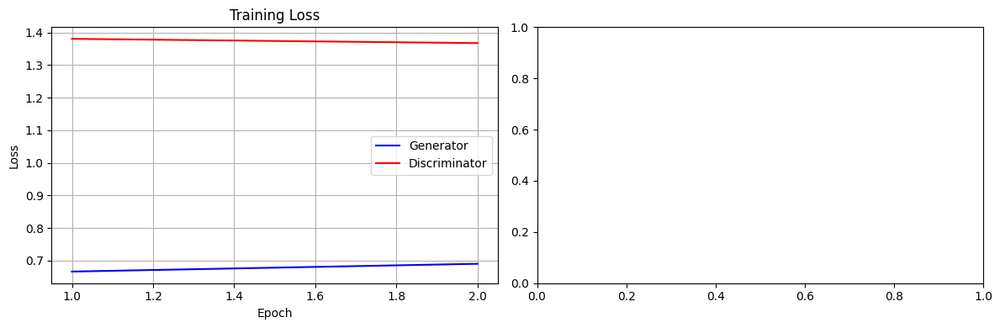

Epoch 3:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   3/50 | G_loss: 0.6896 | D_loss: 1.3672 | Time: 88.4s


Epoch 4:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   4/50 | G_loss: 0.6851 | D_loss: 1.3603 | Time: 117.8s


<Figure size 640x480 with 0 Axes>

Epoch 5:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   5/50 | G_loss: 0.6804 | D_loss: 1.3457 | Time: 147.1s


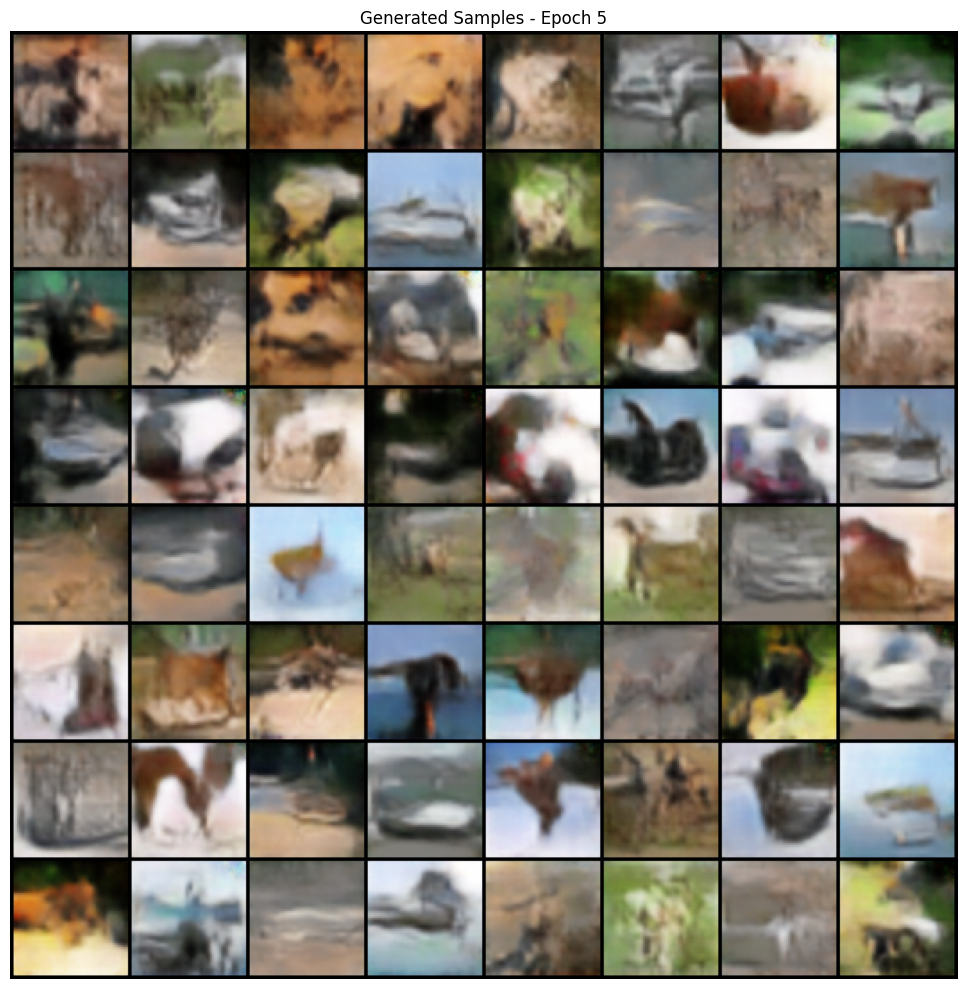

Epoch 6:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   6/50 | G_loss: 0.6777 | D_loss: 1.3434 | Time: 177.4s


<Figure size 640x480 with 0 Axes>

Epoch 7:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   7/50 | G_loss: 0.6774 | D_loss: 1.3426 | Time: 206.9s


Epoch 8:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   8/50 | G_loss: 0.6807 | D_loss: 1.3423 | Time: 236.4s


<Figure size 640x480 with 0 Axes>

Epoch 9:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   9/50 | G_loss: 0.6823 | D_loss: 1.3459 | Time: 266.1s


Epoch 10:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  10/50 | G_loss: 0.6892 | D_loss: 1.3455 | Time: 295.6s


<Figure size 640x480 with 0 Axes>

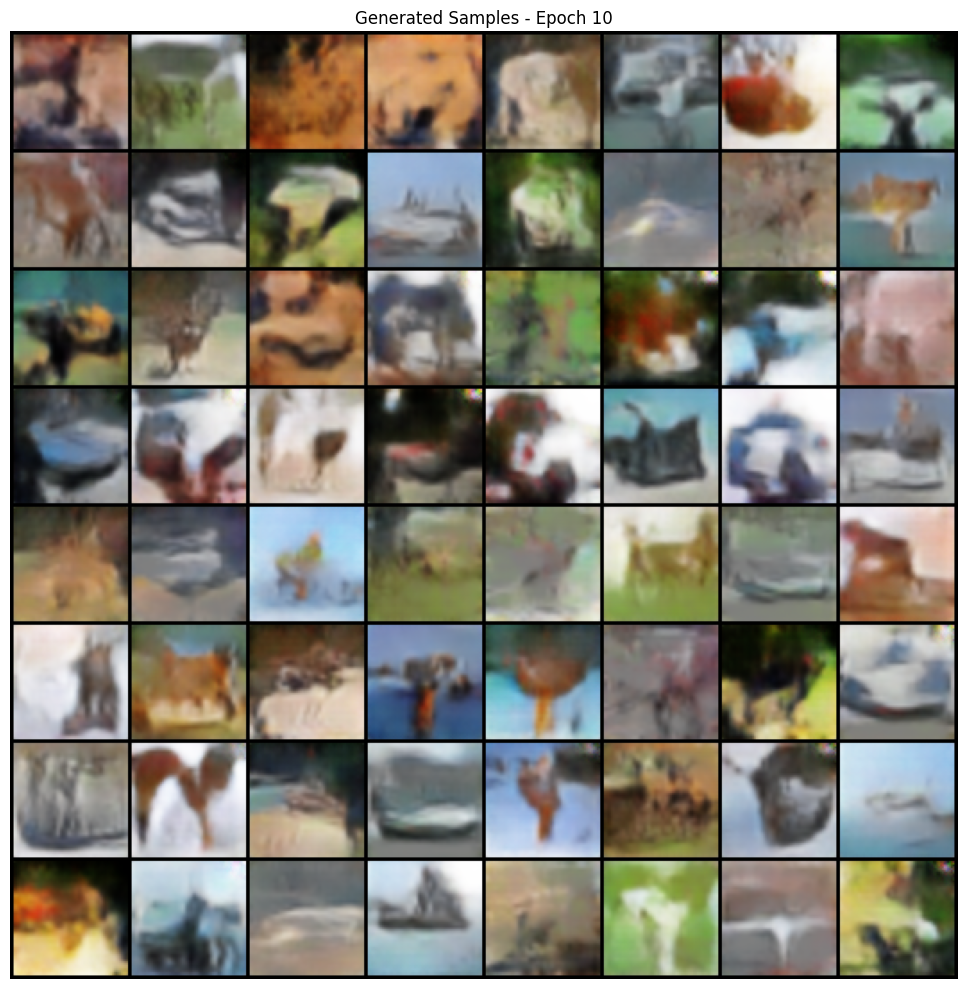

Epoch 11:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  11/50 | G_loss: 0.6920 | D_loss: 1.3448 | Time: 325.8s


Epoch 12:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  12/50 | G_loss: 0.6989 | D_loss: 1.3409 | Time: 355.6s


<Figure size 640x480 with 0 Axes>

Epoch 13:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  13/50 | G_loss: 0.7097 | D_loss: 1.3412 | Time: 385.4s


Epoch 14:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  14/50 | G_loss: 0.7160 | D_loss: 1.3425 | Time: 415.0s


<Figure size 640x480 with 0 Axes>

Epoch 15:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  15/50 | G_loss: 0.7142 | D_loss: 1.3551 | Time: 445.0s


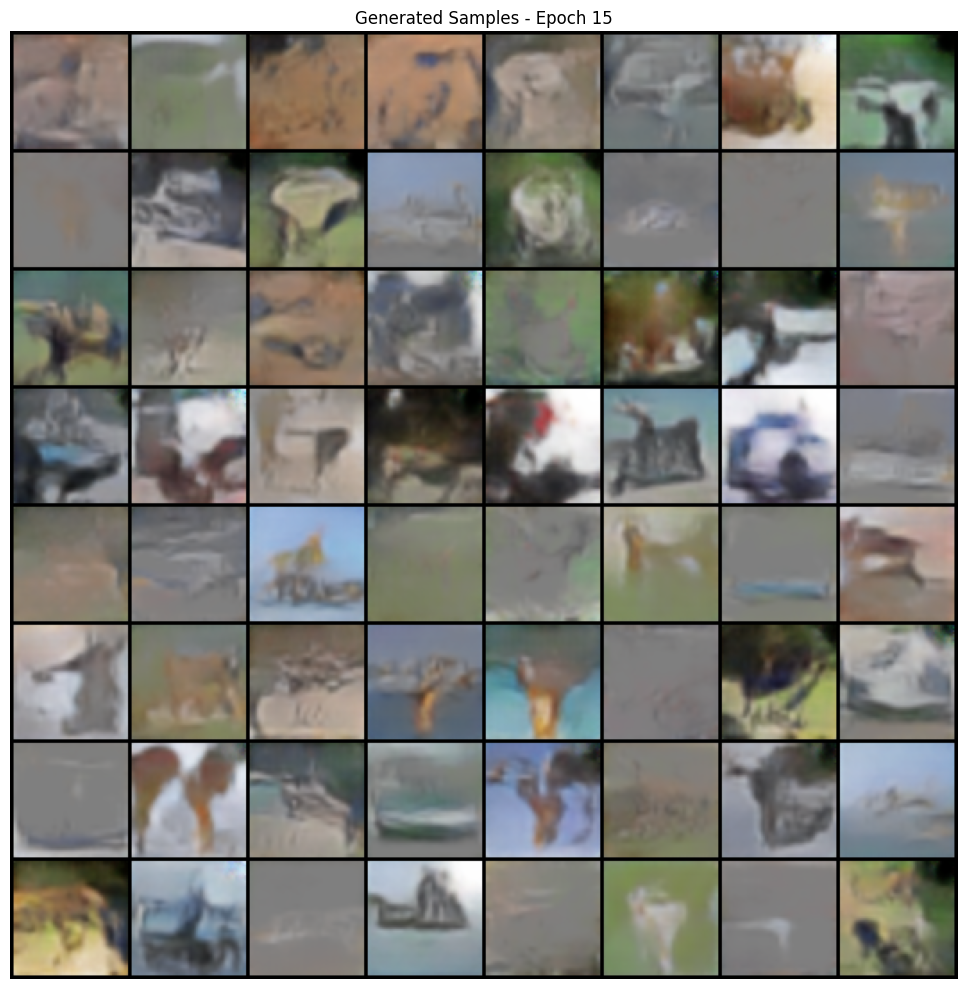

Epoch 16:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  16/50 | G_loss: 0.7121 | D_loss: 1.3551 | Time: 475.4s


<Figure size 640x480 with 0 Axes>

Epoch 17:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  17/50 | G_loss: 0.7098 | D_loss: 1.3540 | Time: 505.0s


Epoch 18:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  18/50 | G_loss: 0.7096 | D_loss: 1.3519 | Time: 534.5s


<Figure size 640x480 with 0 Axes>

Epoch 19:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  19/50 | G_loss: 0.7088 | D_loss: 1.3511 | Time: 564.1s


Epoch 20:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  20/50 | G_loss: 0.7085 | D_loss: 1.3529 | Time: 593.8s


<Figure size 640x480 with 0 Axes>

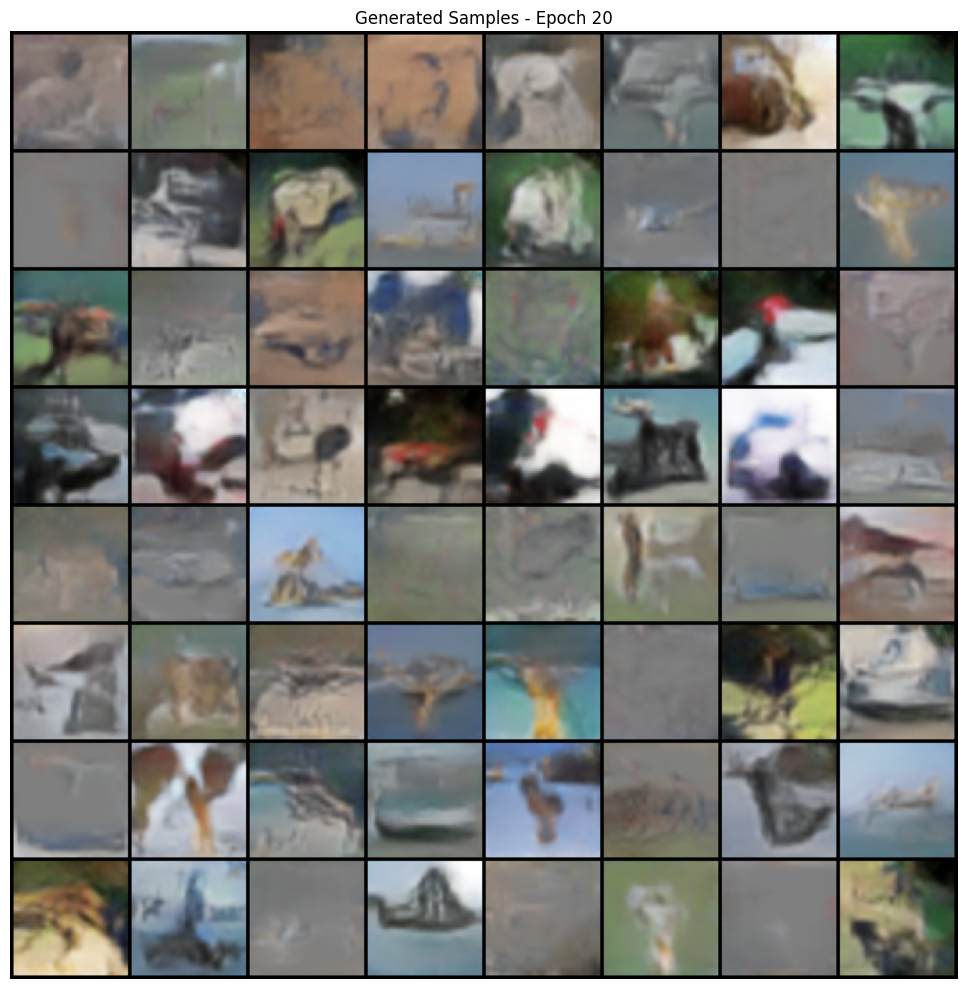

Epoch 21:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  21/50 | G_loss: 0.7065 | D_loss: 1.3537 | Time: 624.7s


Epoch 22:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  22/50 | G_loss: 0.7066 | D_loss: 1.3566 | Time: 654.3s


<Figure size 640x480 with 0 Axes>

Epoch 23:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  23/50 | G_loss: 0.7072 | D_loss: 1.3539 | Time: 684.3s


Epoch 24:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  24/50 | G_loss: 0.7060 | D_loss: 1.3549 | Time: 714.0s


<Figure size 640x480 with 0 Axes>

Epoch 25:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  25/50 | G_loss: 0.7069 | D_loss: 1.3538 | Time: 743.9s


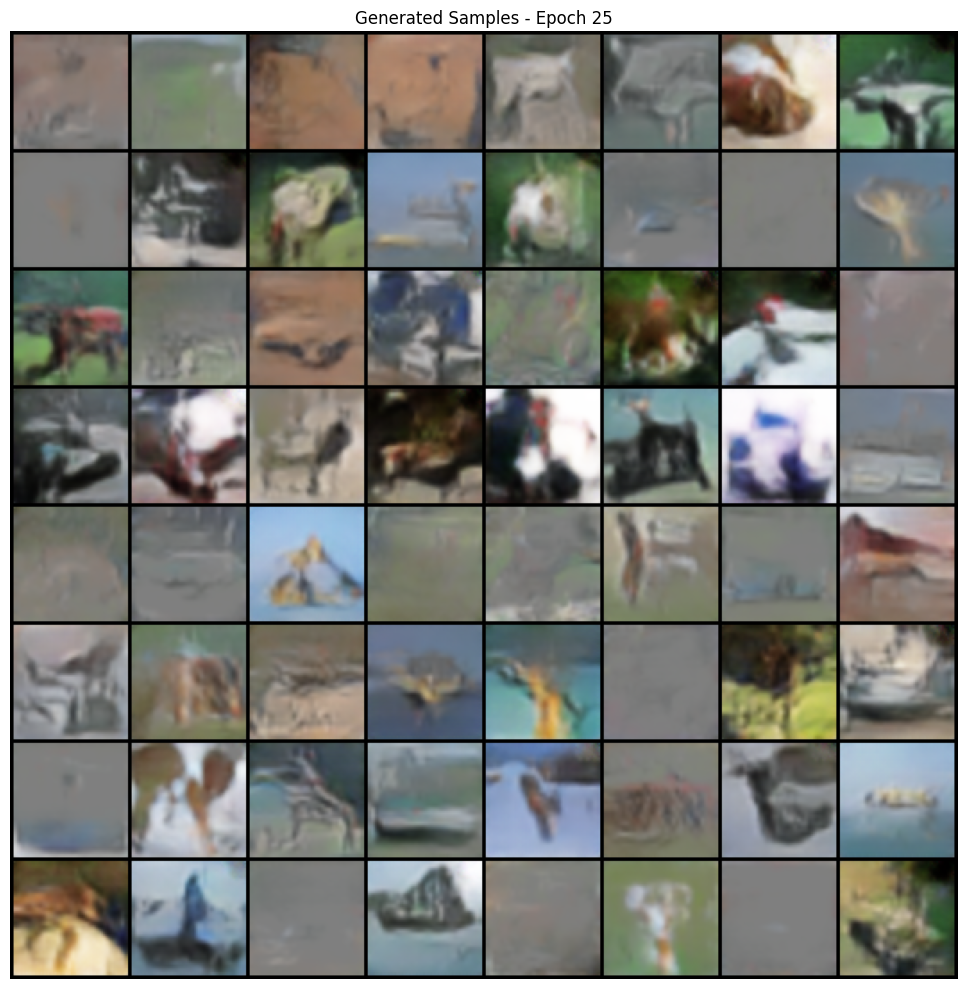

Epoch 26:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  26/50 | G_loss: 0.7068 | D_loss: 1.3524 | Time: 774.6s


<Figure size 640x480 with 0 Axes>

Epoch 27:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  27/50 | G_loss: 0.7070 | D_loss: 1.3522 | Time: 804.8s


Epoch 28:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  28/50 | G_loss: 0.7064 | D_loss: 1.3491 | Time: 834.7s


<Figure size 640x480 with 0 Axes>

Epoch 29:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  29/50 | G_loss: 0.7063 | D_loss: 1.3527 | Time: 864.5s


Epoch 30:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  30/50 | G_loss: 0.7057 | D_loss: 1.3490 | Time: 894.7s


<Figure size 640x480 with 0 Axes>

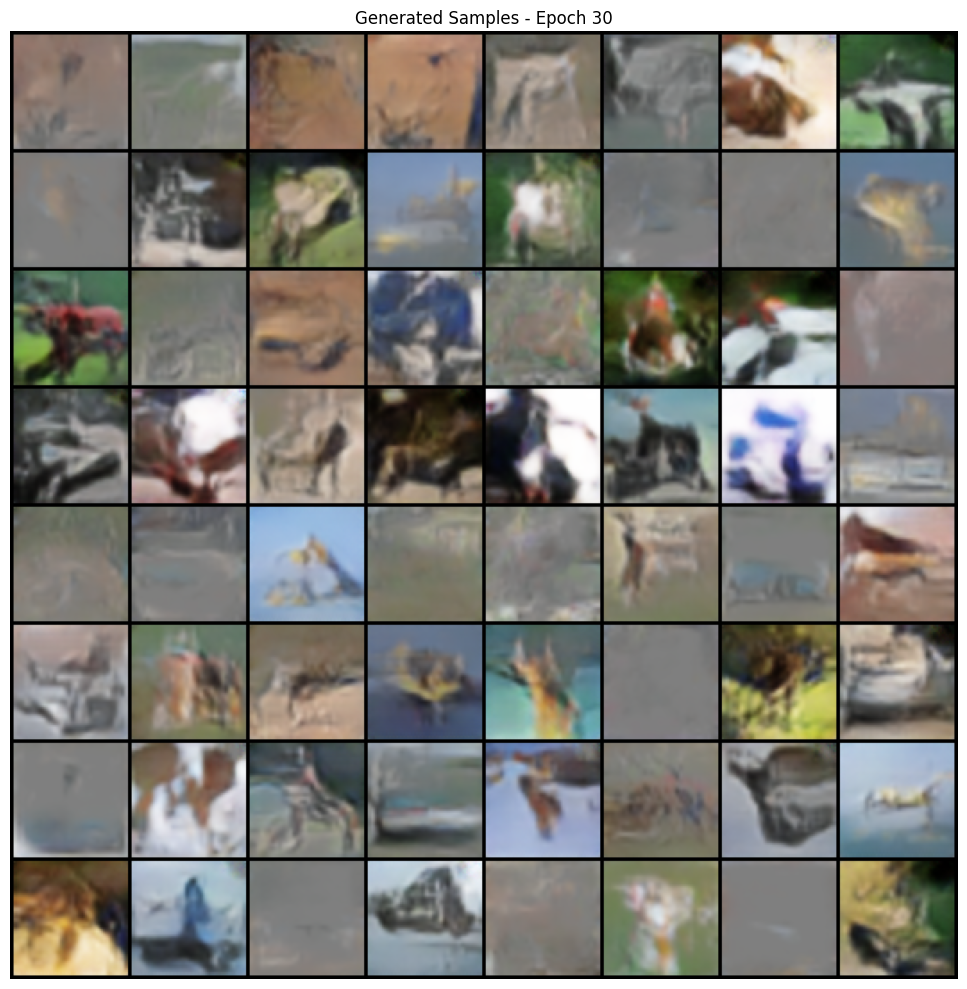

Epoch 31:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  31/50 | G_loss: 0.7057 | D_loss: 1.3509 | Time: 925.4s


Epoch 32:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  32/50 | G_loss: 0.7056 | D_loss: 1.3542 | Time: 955.3s


<Figure size 640x480 with 0 Axes>

Epoch 33:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  33/50 | G_loss: 0.7059 | D_loss: 1.3509 | Time: 985.2s


Epoch 34:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  34/50 | G_loss: 0.7061 | D_loss: 1.3494 | Time: 1015.0s


<Figure size 640x480 with 0 Axes>

Epoch 35:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  35/50 | G_loss: 0.7058 | D_loss: 1.3518 | Time: 1044.8s


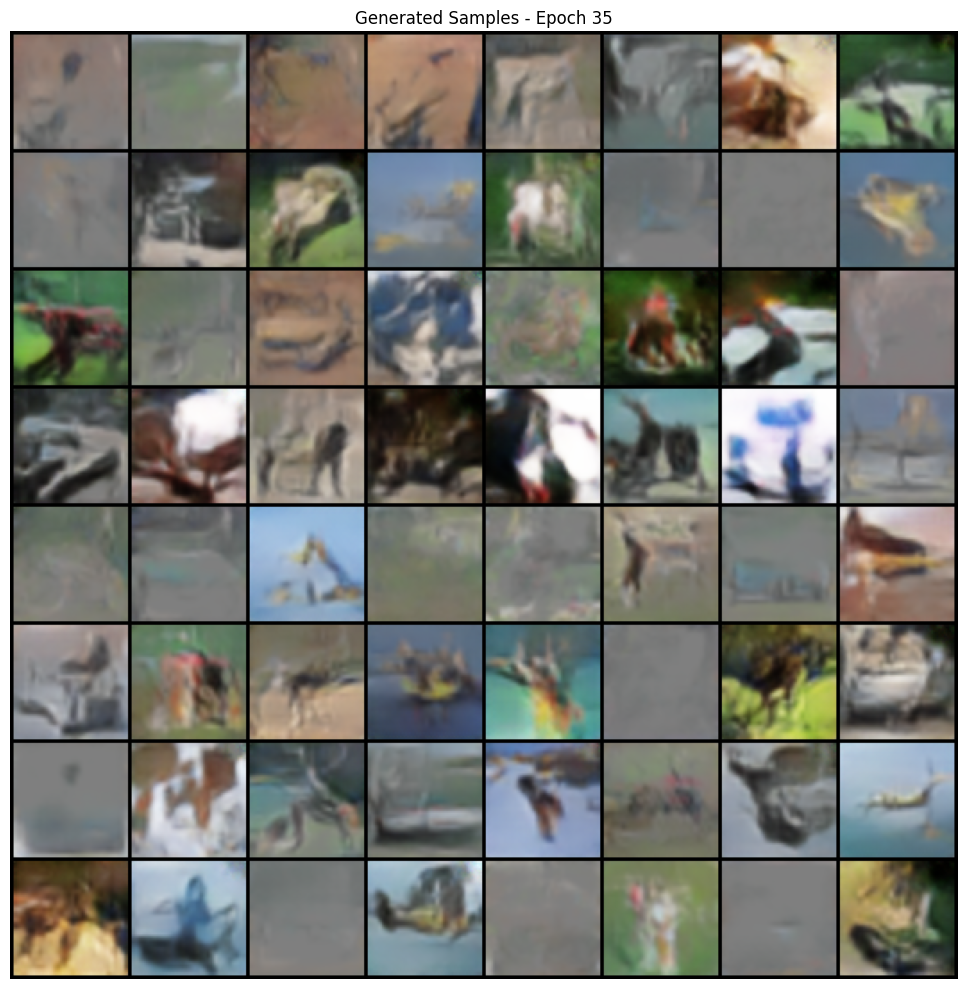

Epoch 36:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  36/50 | G_loss: 0.7069 | D_loss: 1.3478 | Time: 1075.2s


<Figure size 640x480 with 0 Axes>

Epoch 37:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  37/50 | G_loss: 0.7066 | D_loss: 1.3525 | Time: 1104.9s


Epoch 38:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  38/50 | G_loss: 0.7067 | D_loss: 1.3510 | Time: 1134.6s


<Figure size 640x480 with 0 Axes>

Epoch 39:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  39/50 | G_loss: 0.7057 | D_loss: 1.3500 | Time: 1164.3s


Epoch 40:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  40/50 | G_loss: 0.7065 | D_loss: 1.3487 | Time: 1194.1s


<Figure size 640x480 with 0 Axes>

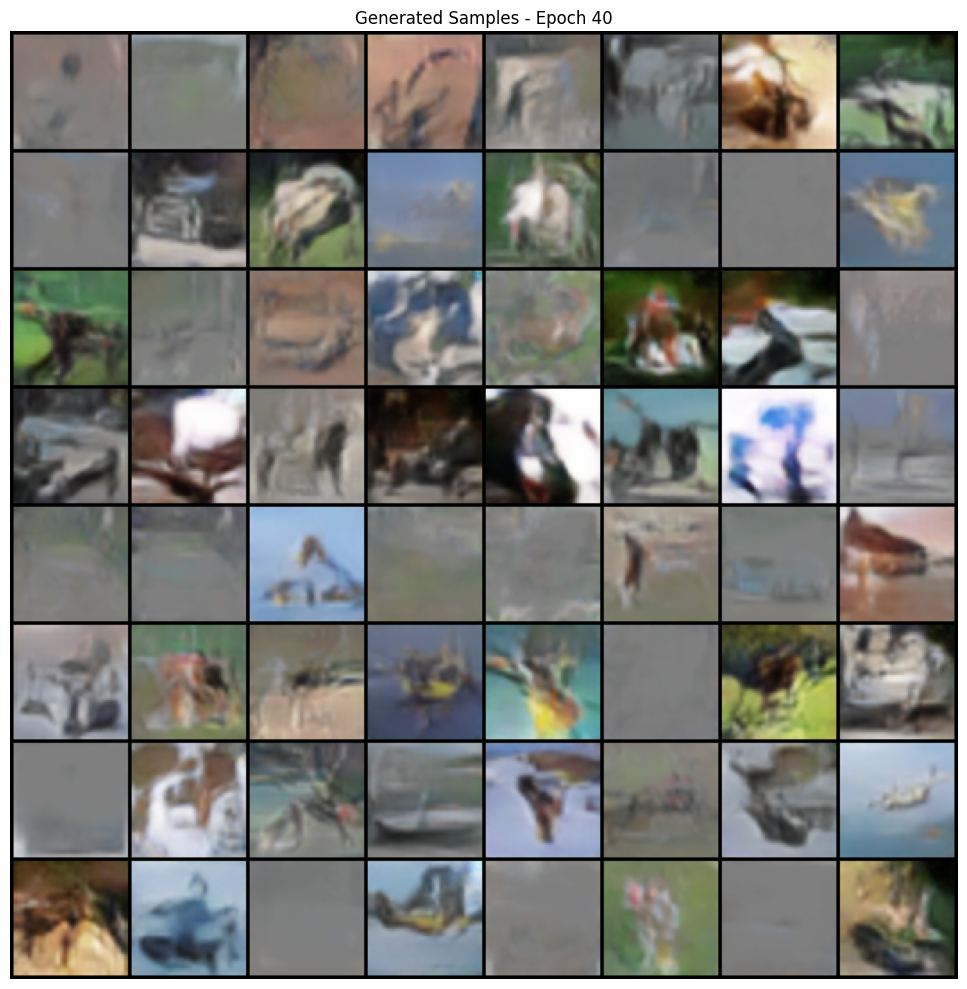

Epoch 41:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  41/50 | G_loss: 0.7054 | D_loss: 1.3521 | Time: 1225.1s


Epoch 42:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  42/50 | G_loss: 0.7056 | D_loss: 1.3510 | Time: 1254.9s


<Figure size 640x480 with 0 Axes>

Epoch 43:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  43/50 | G_loss: 0.7060 | D_loss: 1.3531 | Time: 1285.2s


Epoch 44:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  44/50 | G_loss: 0.7052 | D_loss: 1.3518 | Time: 1315.5s


<Figure size 640x480 with 0 Axes>

Epoch 45:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  45/50 | G_loss: 0.7053 | D_loss: 1.3548 | Time: 1345.8s


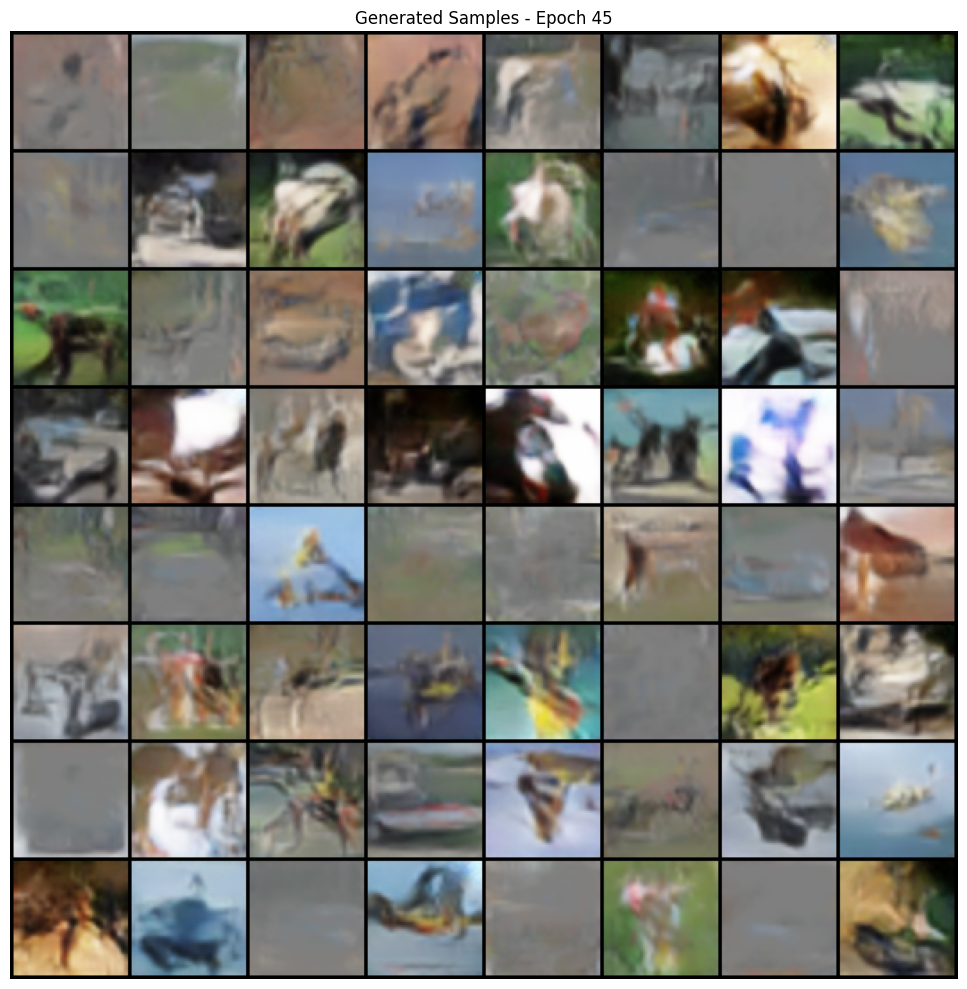

Epoch 46:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  46/50 | G_loss: 0.7046 | D_loss: 1.3540 | Time: 1376.6s


<Figure size 640x480 with 0 Axes>

Epoch 47:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  47/50 | G_loss: 0.7054 | D_loss: 1.3560 | Time: 1406.5s


Epoch 48:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  48/50 | G_loss: 0.7044 | D_loss: 1.3558 | Time: 1436.6s


<Figure size 640x480 with 0 Axes>

Epoch 49:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  49/50 | G_loss: 0.7045 | D_loss: 1.3571 | Time: 1466.8s


Epoch 50:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  50/50 | G_loss: 0.7044 | D_loss: 1.3521 | Time: 1496.6s


<Figure size 640x480 with 0 Axes>

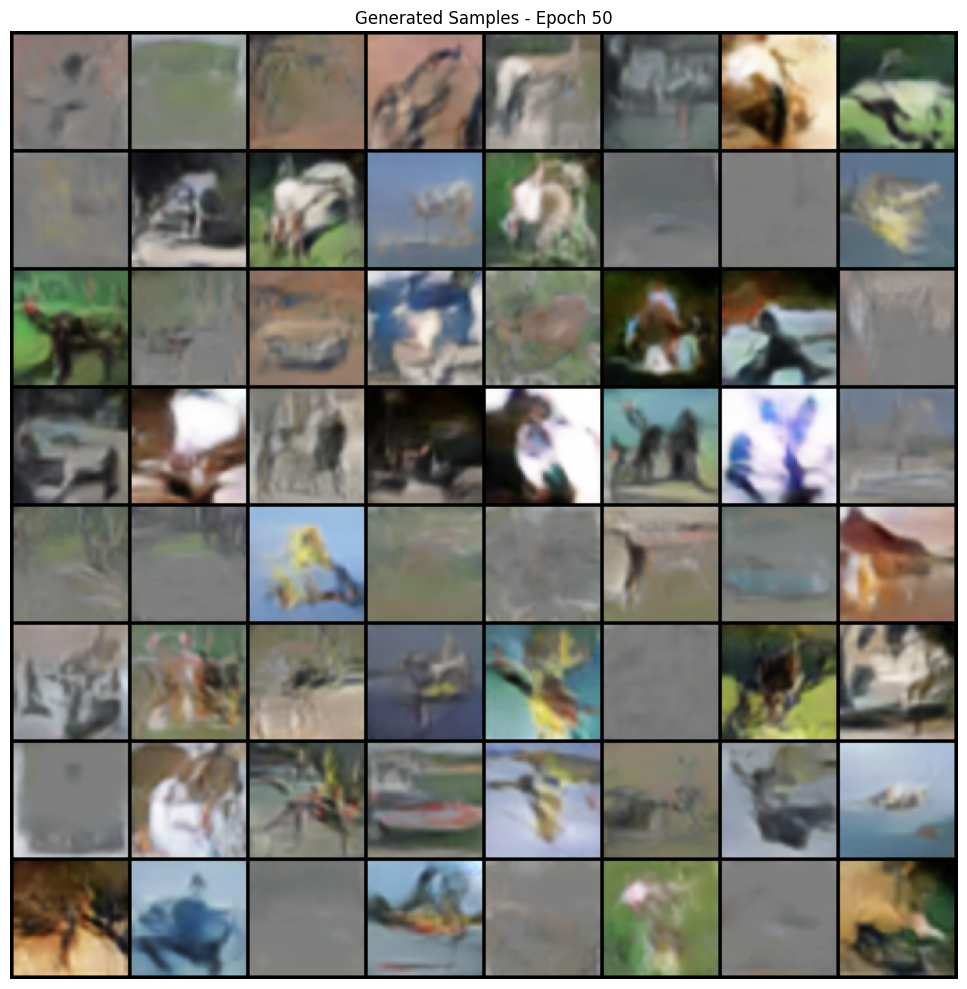


Training completed in 1497.4 seconds (25.0 minutes)


In [21]:
# logging and viz
history = {
    'G_loss': [],
    'D_loss': [],
    'epochs': []
}


plt.ion()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

print("Starting training...")
start_time = time.time()

for epoch in range(1, cfg["epochs"] + 1):
    g_loss, d_loss = train_epoch(epoch)

    # History
    history['G_loss'].append(g_loss)
    history['D_loss'].append(d_loss)
    history['epochs'].append(epoch)

    elapsed = time.time() - start_time
    print(f"Epoch {epoch:3d}/{cfg['epochs']} | G_loss: {g_loss:.4f} | D_loss: {d_loss:.4f} | Time: {elapsed:.1f}s")

    if epoch % 2 == 0:
        ax1.clear()
        ax1.plot(history['epochs'], history['G_loss'], 'b-', label='Generator')
        ax1.plot(history['epochs'], history['D_loss'], 'r-', label='Discriminator')
        ax1.set_xlabel('Epoch')
        ax1.set_ylabel('Loss')
        ax1.set_title('Training Loss')
        ax1.legend()
        ax1.grid(True)

        if epoch % cfg["sample_every"] == 0:
            ax2.clear()
            ema_G.apply_shadow()
            G.eval()
            with torch.no_grad():
                sample = G(fixed_noise[:16])
                grid = utils.make_grid(sample, nrow=4, padding=2, normalize=True)
                ax2.imshow(grid.cpu().permute(1, 2, 0))
                ax2.set_title(f'Samples - Epoch {epoch}')
                ax2.axis('off')
            ema_G.restore()

        plt.tight_layout()
        plt.pause(0.01)

    if epoch % cfg["sample_every"] == 0:
        save_samples(epoch)

    if epoch % cfg["save_every"] == 0:
        ema_G.apply_shadow()
        checkpoint = {
            'epoch': epoch,
            'G_state_dict': G.state_dict(),
            'D_state_dict': D.state_dict(),
            'opt_G_state_dict': opt_G.state_dict(),
            'opt_D_state_dict': opt_D.state_dict(),
            'ema_shadow': ema_G.shadow,
            'history': history,
            'config': cfg
        }
        torch.save(checkpoint, f"{cfg['ckpt_dir']}/checkpoint_epoch_{epoch:03d}.pth")
        ema_G.restore()

plt.ioff()
total_time = time.time() - start_time
print(f"\nTraining completed in {total_time:.1f} seconds ({total_time/60:.1f} minutes)")

In [12]:
!pip install -q torchmetrics torch-fidelity

from torchmetrics.image.inception import InceptionScore
from torch_fidelity import calculate_metrics

print("Evaluating final model...")

ema_G.apply_shadow()
G.eval()

n_eval_samples = 5000
eval_samples = []

with torch.no_grad():
    for i in tqdm(range(0, n_eval_samples, 64), desc="Generating samples"):
        batch_size = min(64, n_eval_samples - i)
        z = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
        samples = G(z)
        eval_samples.append(samples.cpu())

eval_samples = torch.cat(eval_samples, 0)
eval_samples = (eval_samples + 1) / 2

is_metric = InceptionScore(splits=10, normalize=True)
is_mean, is_std = is_metric(eval_samples)
print(f"Inception Score: {is_mean:.3f} ± {is_std:.3f}")

real_samples = []
for batch, _ in tqdm(val_loader, desc="Loading real samples"):
    real_samples.append((batch + 1) / 2)
    if len(real_samples) * cfg["batch_size"] >= n_eval_samples:
        break

real_samples = torch.cat(real_samples, 0)[:n_eval_samples]

try:
    metrics = calculate_metrics(
        input1=eval_samples[:min(len(eval_samples), len(real_samples))],
        input2=real_samples[:min(len(eval_samples), len(real_samples))],
        metrics=["fid"]
    )
    print(f"FID Score: {metrics['frechet_inception_distance']:.3f}")
except Exception as e:
    print(f"FID calculation failed: {e}")

ema_G.restore()

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 962.5/962.5 kB 17.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 126.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 101.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 44.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 20.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 106.9 MB/s eta 0:00:00
Evaluating final model...


Generating samples:   0%|          | 0/79 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/torchmetrics/utilities/prints.py:43: UserWarning: Metric `InceptionScore` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)
Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 313MB/s]


Inception Score: 3.656 ± 0.139


Loading real samples:   0%|          | 0/40 [00:00<?, ?it/s]

FID calculation failed: At least one of "isc", "fid", "kid", "ppl" metrics must be specified


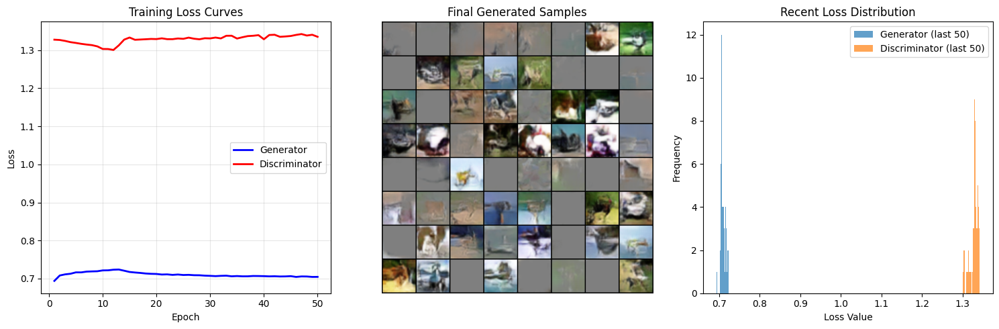

Generating diverse sample set...


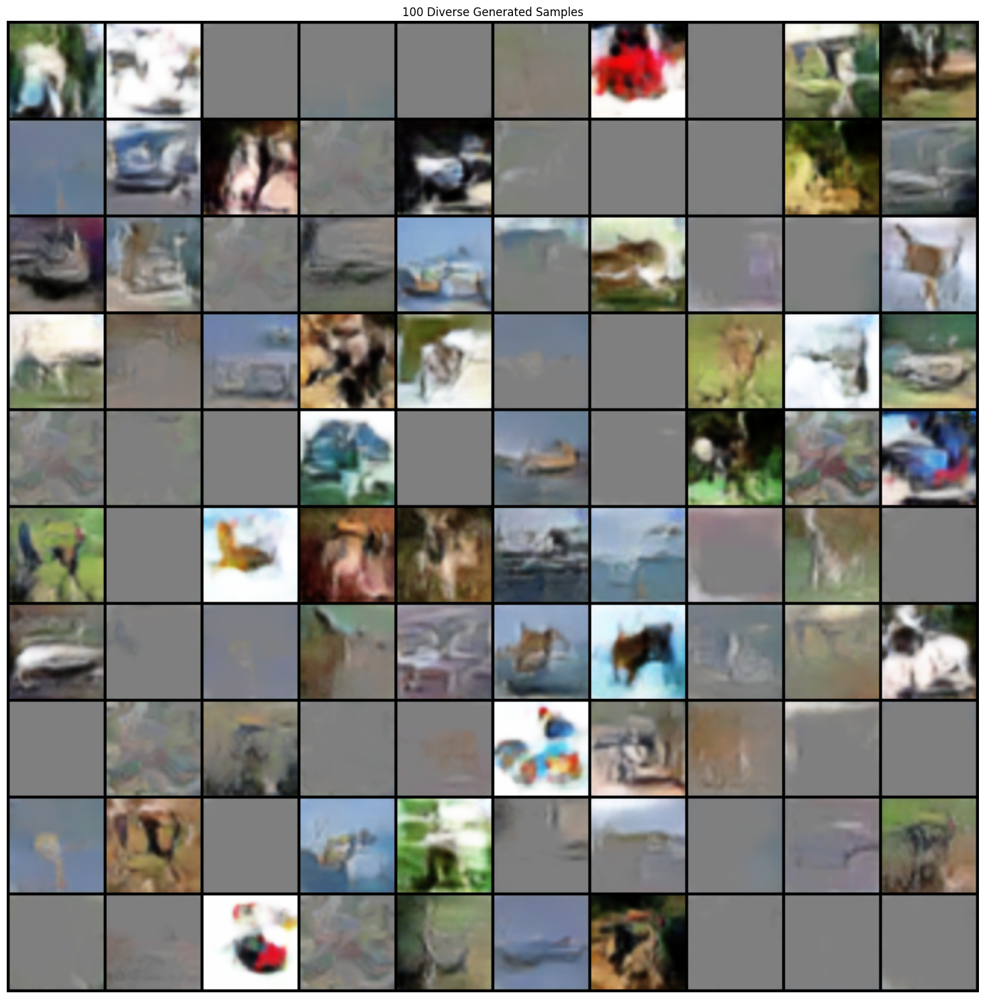

In [13]:
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(history['epochs'], history['G_loss'], 'b-', linewidth=2, label='Generator')
plt.plot(history['epochs'], history['D_loss'], 'r-', linewidth=2, label='Discriminator')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training Loss Curves')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 2)
ema_G.apply_shadow()
G.eval()
with torch.no_grad():
    final_samples = G(fixed_noise)
    grid = utils.make_grid(final_samples, nrow=8, padding=2, normalize=True)
    plt.imshow(grid.cpu().permute(1, 2, 0))
    plt.title(f'Final Generated Samples')
    plt.axis('off')

plt.subplot(1, 3, 3)
plt.hist(history['G_loss'][-50:], alpha=0.7, label='Generator (last 50)', bins=20)
plt.hist(history['D_loss'][-50:], alpha=0.7, label='Discriminator (last 50)', bins=20)
plt.xlabel('Loss Value')
plt.ylabel('Frequency')
plt.title('Recent Loss Distribution')
plt.legend()

plt.tight_layout()
plt.savefig(f"{cfg['sample_dir']}/final_results.png", dpi=300, bbox_inches='tight')
plt.show()

print("Generating diverse sample set...")
with torch.no_grad():
    diverse_z = torch.randn(100, cfg["nz"], 1, 1, device=device)
    diverse_samples = G(diverse_z)
    diverse_grid = utils.make_grid(diverse_samples, nrow=10, padding=2, normalize=True)

plt.figure(figsize=(15, 15))
plt.imshow(diverse_grid.cpu().permute(1, 2, 0))
plt.title('100 Diverse Generated Samples')
plt.axis('off')
plt.tight_layout()
plt.savefig(f"{cfg['sample_dir']}/diverse_samples.png", dpi=300, bbox_inches='tight')
plt.show()

ema_G.restore()

# Experiment 2 with ELU hidden layer



In [15]:

nz = cfg["nz"]
ngf = 64
nc = 3


class Generator_ELU(nn.Module):
    def __init__(self, nz=100, ngf=64, nc=3):
        super(Generator_ELU, self).__init__()
        self.main = nn.Sequential(

            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ELU(inplace=True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ELU(inplace=True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ELU(inplace=True),

            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ELU(inplace=True),
            

            
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

G_elu = Generator_ELU(nz, ngf, nc).to(device)

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

G_elu.apply(weights_init)

print(f"Parameters: {sum(p.numel() for p in G_elu.parameters()):,}")


Parameters: 3,806,080


In [16]:
num_epochs_exp = 50

optimizer_G_elu = torch.optim.Adam(G_elu.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_elu = torch.optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))

try:
    ema_G_elu = EMA(G_elu, decay=0.999)
except:
    try:
        ema_G_elu = EMA(G_elu, 0.999)
    except:
        print("EMA initialization failed - doing it  without EMA")
        ema_G_elu = None
G_losses_elu = []
D_losses_elu = []


start_time = time.time()



Starting ELU training...


Epoch 1:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   1/50 | G_loss: 0.7656 | D_loss: 1.2645 | Time: 29.1s


Epoch 2:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   2/50 | G_loss: 0.7917 | D_loss: 1.2539 | Time: 57.9s


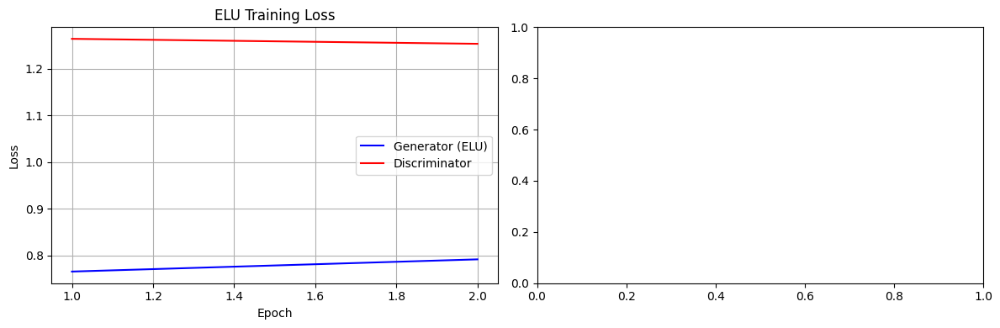

Epoch 3:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   3/50 | G_loss: 0.7416 | D_loss: 1.2641 | Time: 87.3s


Epoch 4:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   4/50 | G_loss: 0.7721 | D_loss: 1.2524 | Time: 116.1s


<Figure size 640x480 with 0 Axes>

Epoch 5:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   5/50 | G_loss: 0.7276 | D_loss: 1.2767 | Time: 145.1s


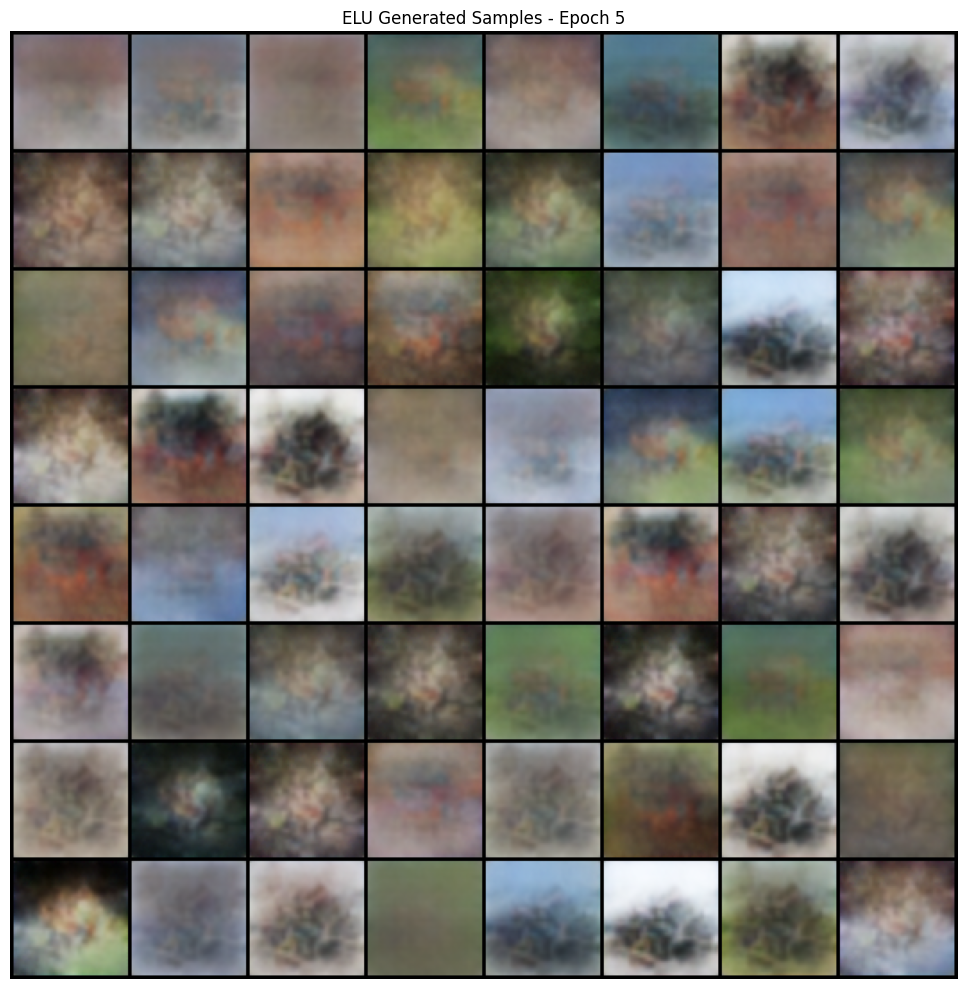

Epoch 6:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   6/50 | G_loss: 0.7293 | D_loss: 1.2926 | Time: 175.1s


<Figure size 640x480 with 0 Axes>

Epoch 7:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   7/50 | G_loss: 0.7463 | D_loss: 1.2812 | Time: 204.2s


Epoch 8:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   8/50 | G_loss: 0.7368 | D_loss: 1.2750 | Time: 233.3s


<Figure size 640x480 with 0 Axes>

Epoch 9:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch   9/50 | G_loss: 0.7375 | D_loss: 1.2612 | Time: 262.4s


Epoch 10:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  10/50 | G_loss: 0.7222 | D_loss: 1.2811 | Time: 291.9s


<Figure size 640x480 with 0 Axes>

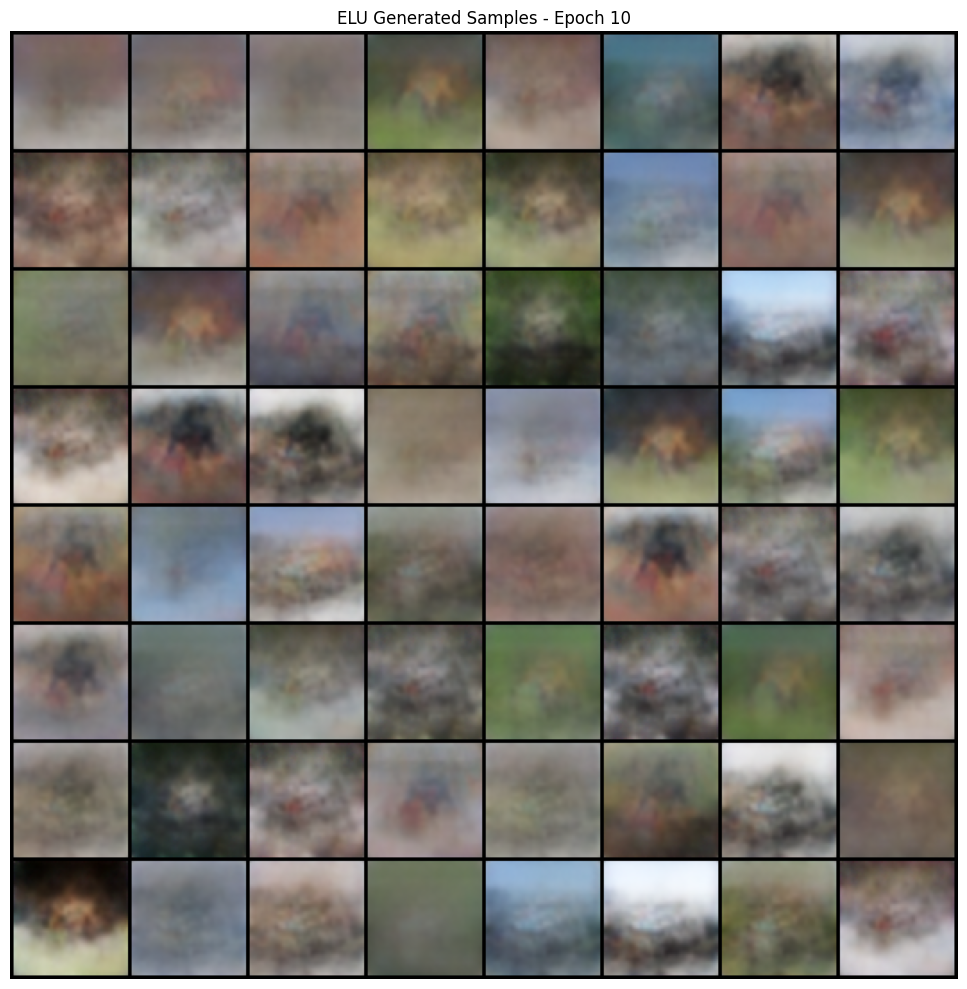

Epoch 11:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  11/50 | G_loss: 0.7207 | D_loss: 1.2734 | Time: 322.2s


Epoch 12:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  12/50 | G_loss: 0.7404 | D_loss: 1.2667 | Time: 351.6s


<Figure size 640x480 with 0 Axes>

Epoch 13:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  13/50 | G_loss: 0.7278 | D_loss: 1.2685 | Time: 381.1s


Epoch 14:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  14/50 | G_loss: 0.7134 | D_loss: 1.2787 | Time: 410.5s


<Figure size 640x480 with 0 Axes>

Epoch 15:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  15/50 | G_loss: 0.7357 | D_loss: 1.2660 | Time: 440.0s


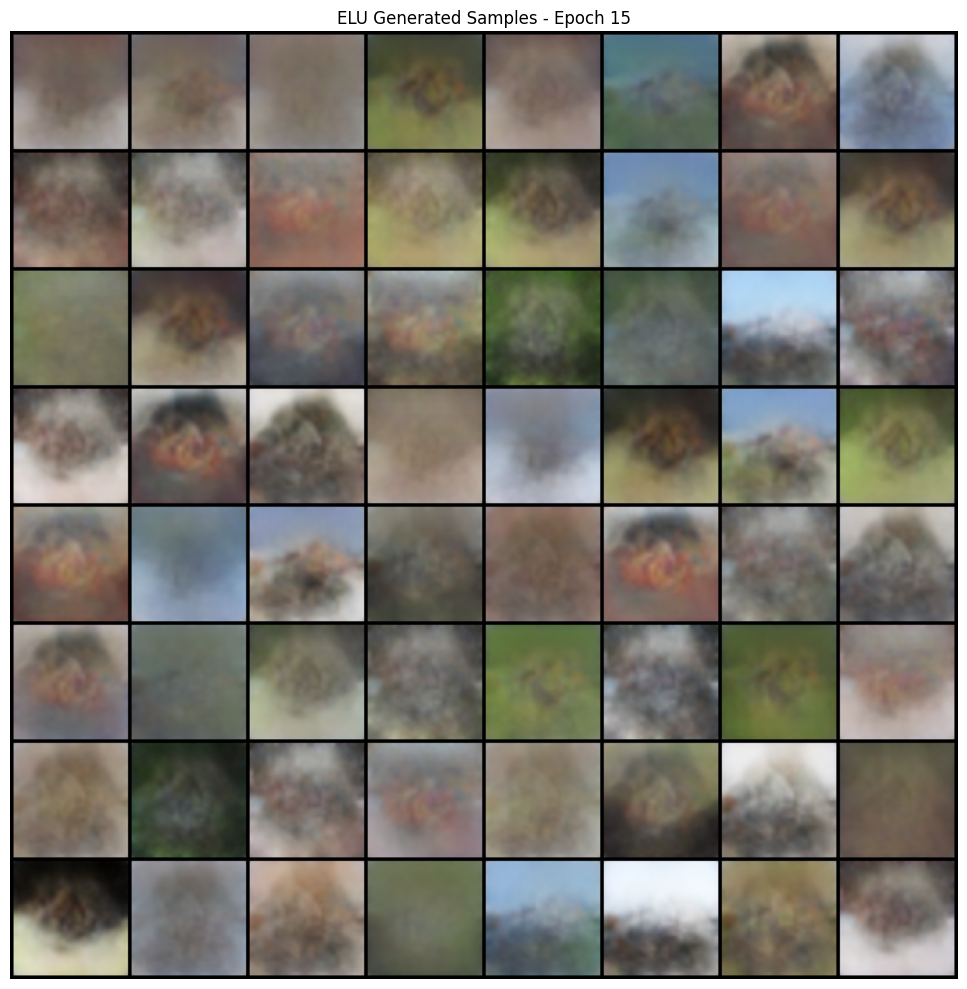

Epoch 16:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  16/50 | G_loss: 0.7336 | D_loss: 1.2506 | Time: 470.2s


<Figure size 640x480 with 0 Axes>

Epoch 17:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  17/50 | G_loss: 0.7167 | D_loss: 1.2757 | Time: 499.5s


Epoch 18:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  18/50 | G_loss: 0.7189 | D_loss: 1.2654 | Time: 528.9s


<Figure size 640x480 with 0 Axes>

Epoch 19:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  19/50 | G_loss: 0.7138 | D_loss: 1.2688 | Time: 558.5s


Epoch 20:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  20/50 | G_loss: 0.7290 | D_loss: 1.2589 | Time: 587.8s


<Figure size 640x480 with 0 Axes>

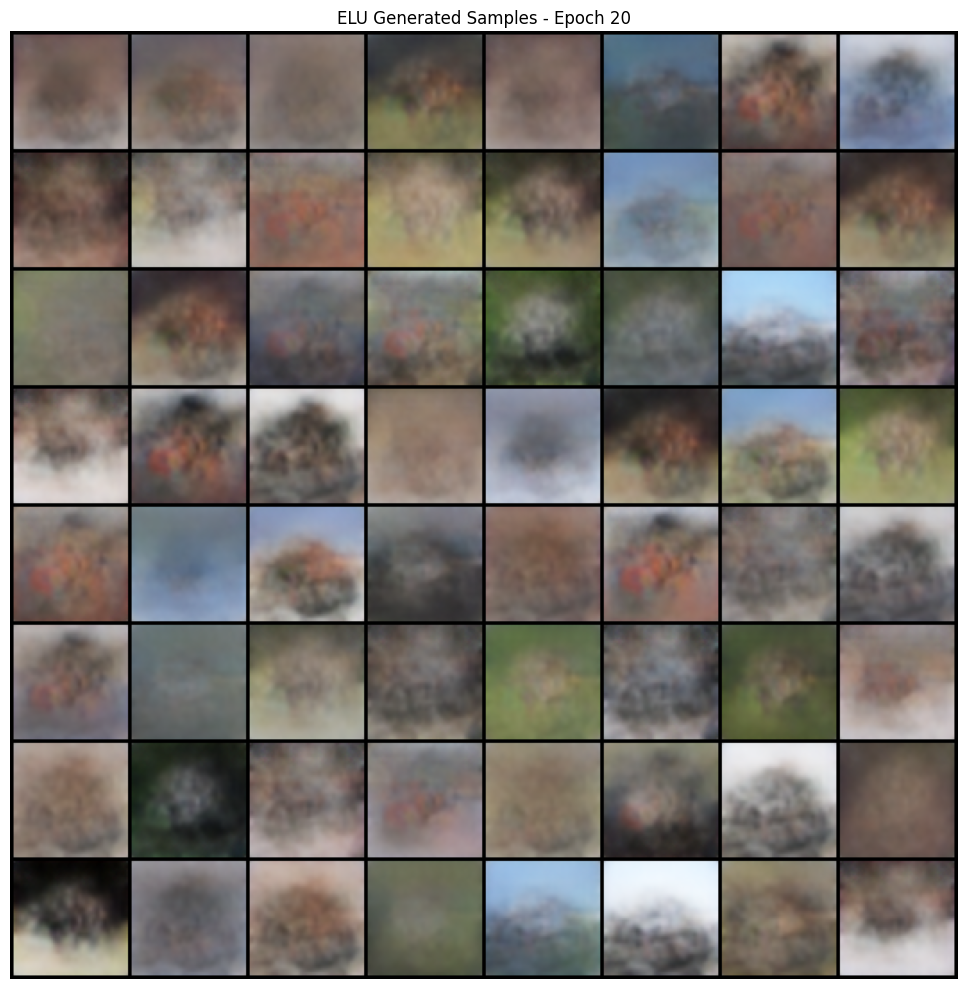

Epoch 21:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  21/50 | G_loss: 0.7127 | D_loss: 1.2598 | Time: 618.1s


Epoch 22:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  22/50 | G_loss: 0.7275 | D_loss: 1.2680 | Time: 647.7s


<Figure size 640x480 with 0 Axes>

Epoch 23:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  23/50 | G_loss: 0.7194 | D_loss: 1.2509 | Time: 677.1s


Epoch 24:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  24/50 | G_loss: 0.7210 | D_loss: 1.2648 | Time: 706.4s


<Figure size 640x480 with 0 Axes>

Epoch 25:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  25/50 | G_loss: 0.7301 | D_loss: 1.2652 | Time: 735.8s


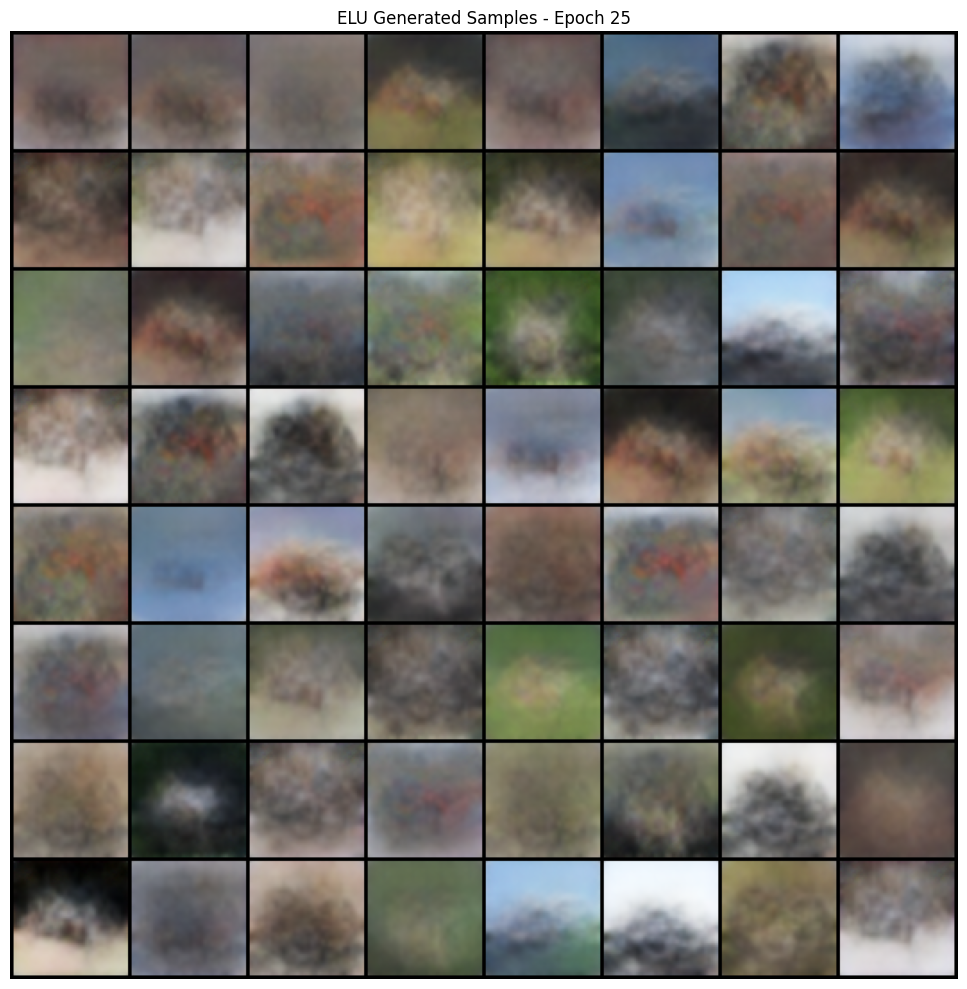

Epoch 26:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  26/50 | G_loss: 0.7108 | D_loss: 1.2564 | Time: 765.7s


<Figure size 640x480 with 0 Axes>

Epoch 27:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  27/50 | G_loss: 0.7175 | D_loss: 1.2612 | Time: 795.0s


Epoch 28:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  28/50 | G_loss: 0.7061 | D_loss: 1.2792 | Time: 824.5s


<Figure size 640x480 with 0 Axes>

Epoch 29:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  29/50 | G_loss: 0.7033 | D_loss: 1.2800 | Time: 854.1s


Epoch 30:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  30/50 | G_loss: 0.7315 | D_loss: 1.2629 | Time: 883.5s


<Figure size 640x480 with 0 Axes>

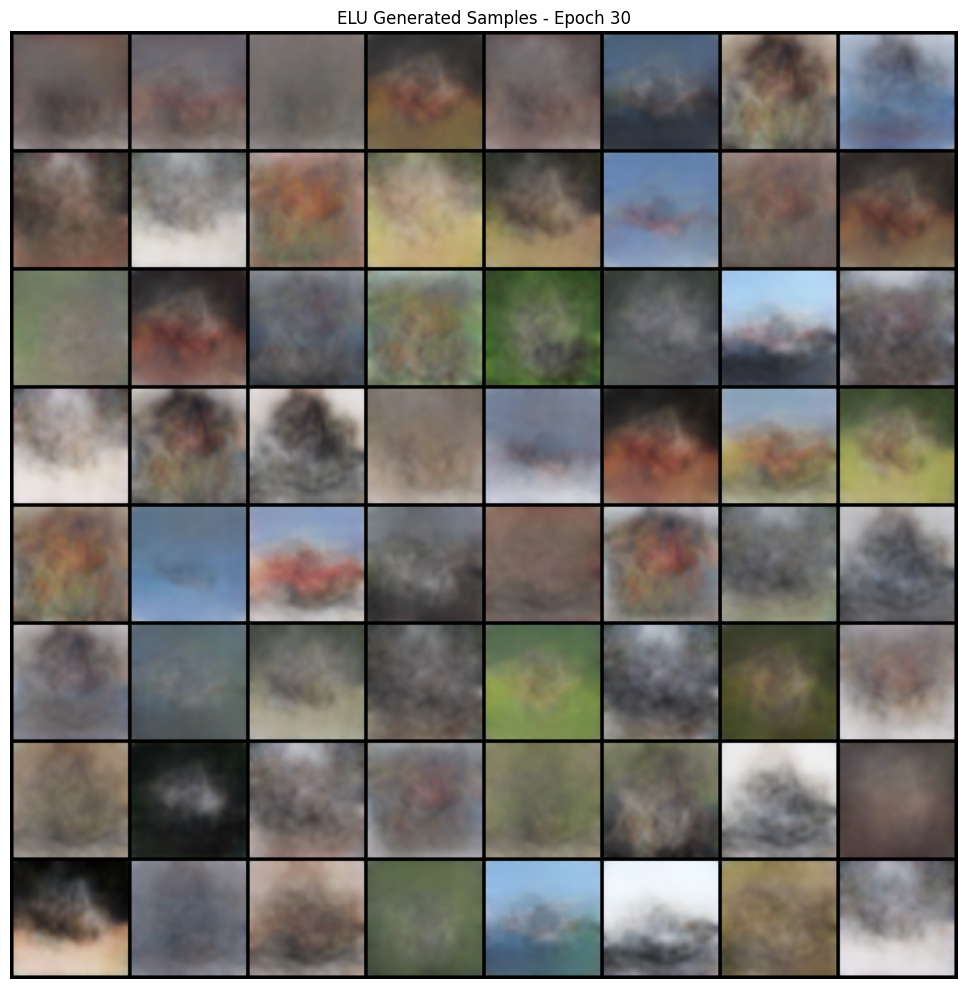

Epoch 31:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  31/50 | G_loss: 0.7163 | D_loss: 1.2411 | Time: 913.6s


Epoch 32:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  32/50 | G_loss: 0.7158 | D_loss: 1.2454 | Time: 943.0s


<Figure size 640x480 with 0 Axes>

Epoch 33:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  33/50 | G_loss: 0.7206 | D_loss: 1.2514 | Time: 972.7s


Epoch 34:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  34/50 | G_loss: 0.7078 | D_loss: 1.2584 | Time: 1002.0s


<Figure size 640x480 with 0 Axes>

Epoch 35:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  35/50 | G_loss: 0.7359 | D_loss: 1.2530 | Time: 1031.4s


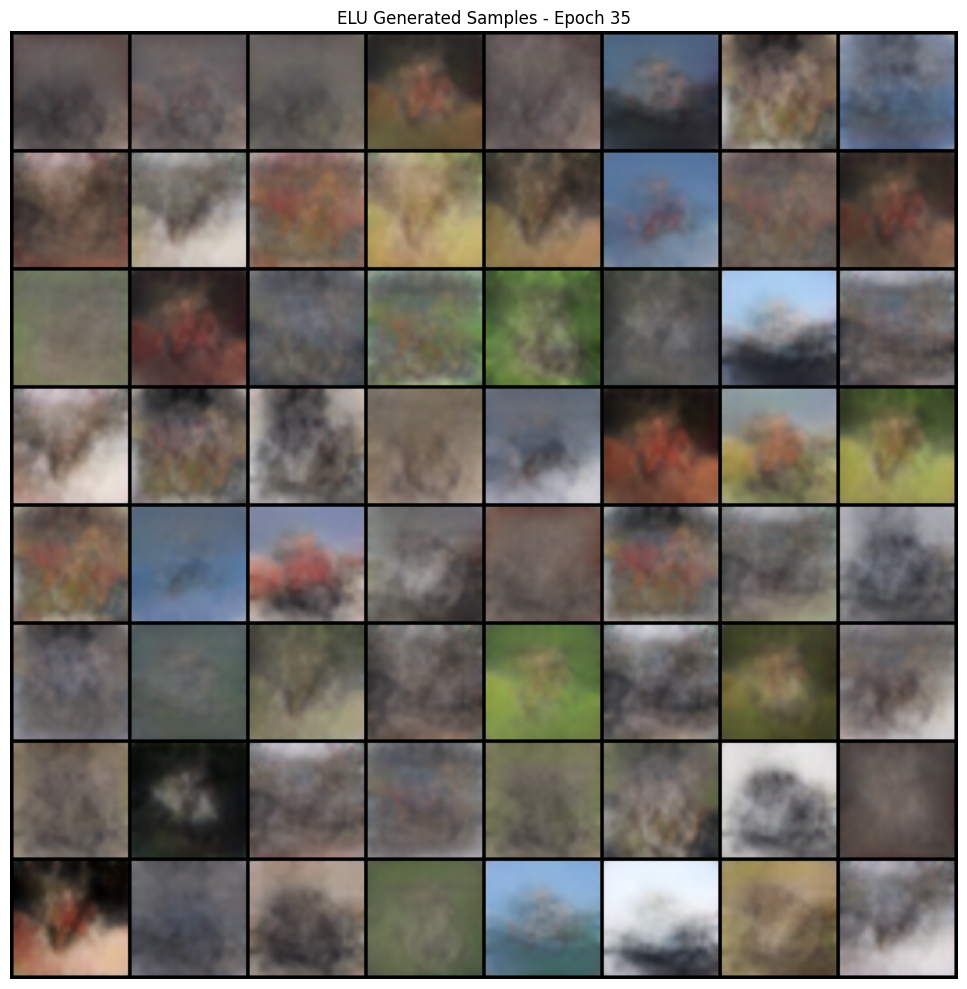

Epoch 36:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  36/50 | G_loss: 0.7135 | D_loss: 1.2458 | Time: 1061.2s


<Figure size 640x480 with 0 Axes>

Epoch 37:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  37/50 | G_loss: 0.7091 | D_loss: 1.2552 | Time: 1090.6s


Epoch 38:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  38/50 | G_loss: 0.7078 | D_loss: 1.2649 | Time: 1119.9s


<Figure size 640x480 with 0 Axes>

Epoch 39:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  39/50 | G_loss: 0.7209 | D_loss: 1.2422 | Time: 1149.2s


Epoch 40:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  40/50 | G_loss: 0.7001 | D_loss: 1.2568 | Time: 1178.5s


<Figure size 640x480 with 0 Axes>

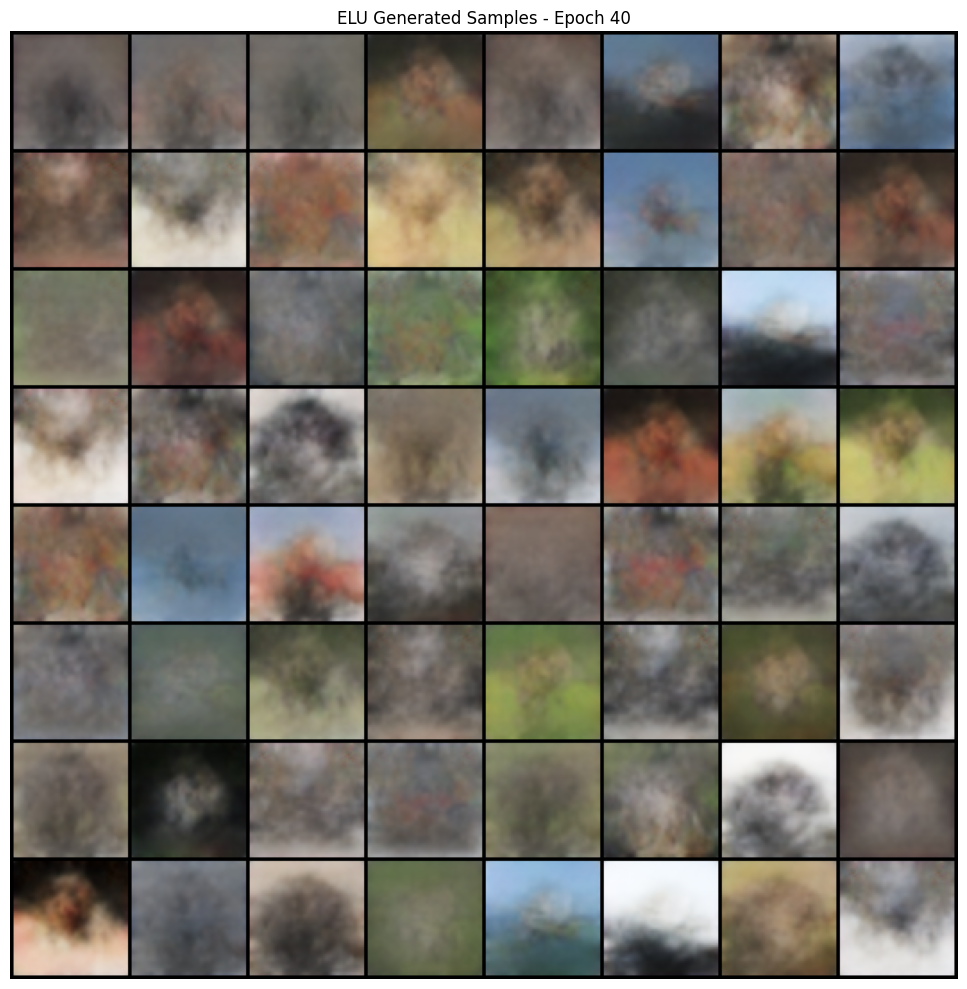

Epoch 41:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  41/50 | G_loss: 0.7087 | D_loss: 1.2634 | Time: 1208.6s


Epoch 42:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  42/50 | G_loss: 0.7143 | D_loss: 1.2452 | Time: 1238.1s


<Figure size 640x480 with 0 Axes>

Epoch 43:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  43/50 | G_loss: 0.7147 | D_loss: 1.2426 | Time: 1267.9s


Epoch 44:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  44/50 | G_loss: 0.7026 | D_loss: 1.2549 | Time: 1297.2s


<Figure size 640x480 with 0 Axes>

Epoch 45:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  45/50 | G_loss: 0.7216 | D_loss: 1.2457 | Time: 1326.5s


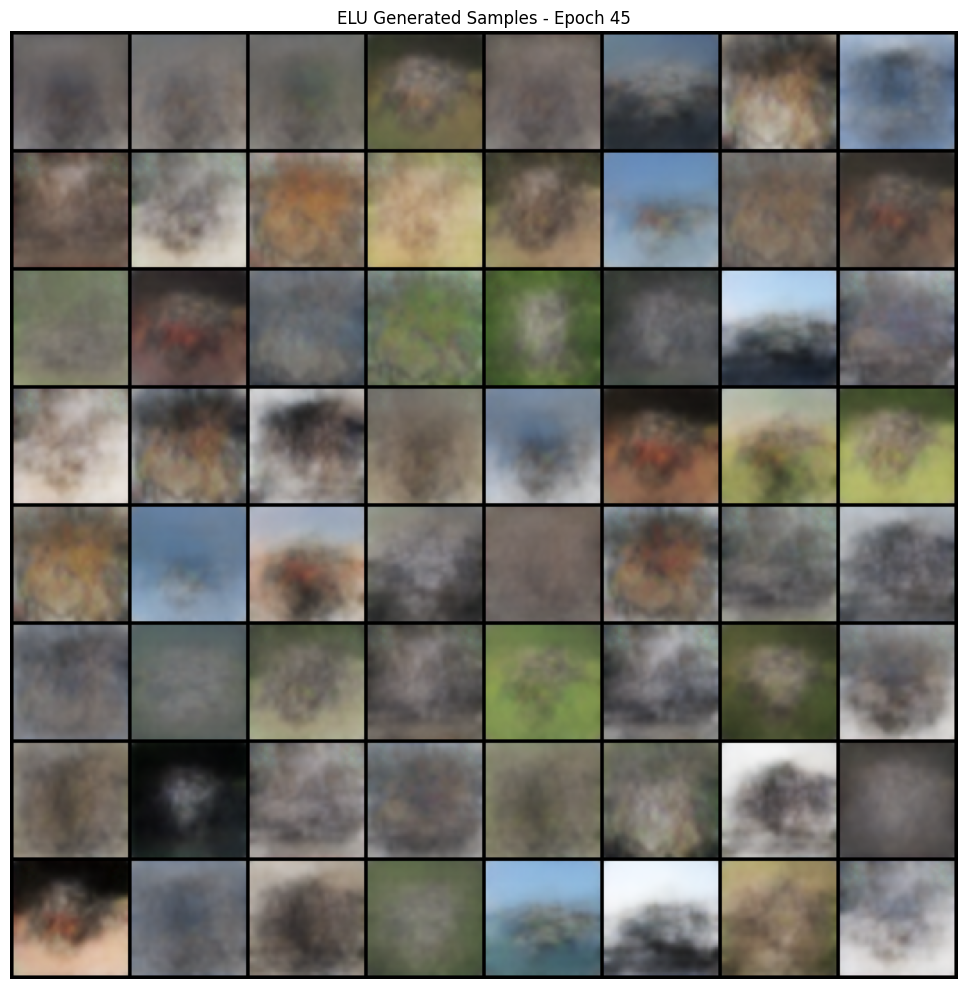

Epoch 46:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  46/50 | G_loss: 0.7037 | D_loss: 1.2411 | Time: 1356.4s


<Figure size 640x480 with 0 Axes>

Epoch 47:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  47/50 | G_loss: 0.7085 | D_loss: 1.2413 | Time: 1385.6s


Epoch 48:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  48/50 | G_loss: 0.7097 | D_loss: 1.2408 | Time: 1414.9s


<Figure size 640x480 with 0 Axes>

Epoch 49:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  49/50 | G_loss: 0.7040 | D_loss: 1.2407 | Time: 1444.2s


Epoch 50:   0%|          | 0/351 [00:00<?, ?it/s]

Epoch  50/50 | G_loss: 0.7065 | D_loss: 1.2398 | Time: 1473.4s


<Figure size 640x480 with 0 Axes>

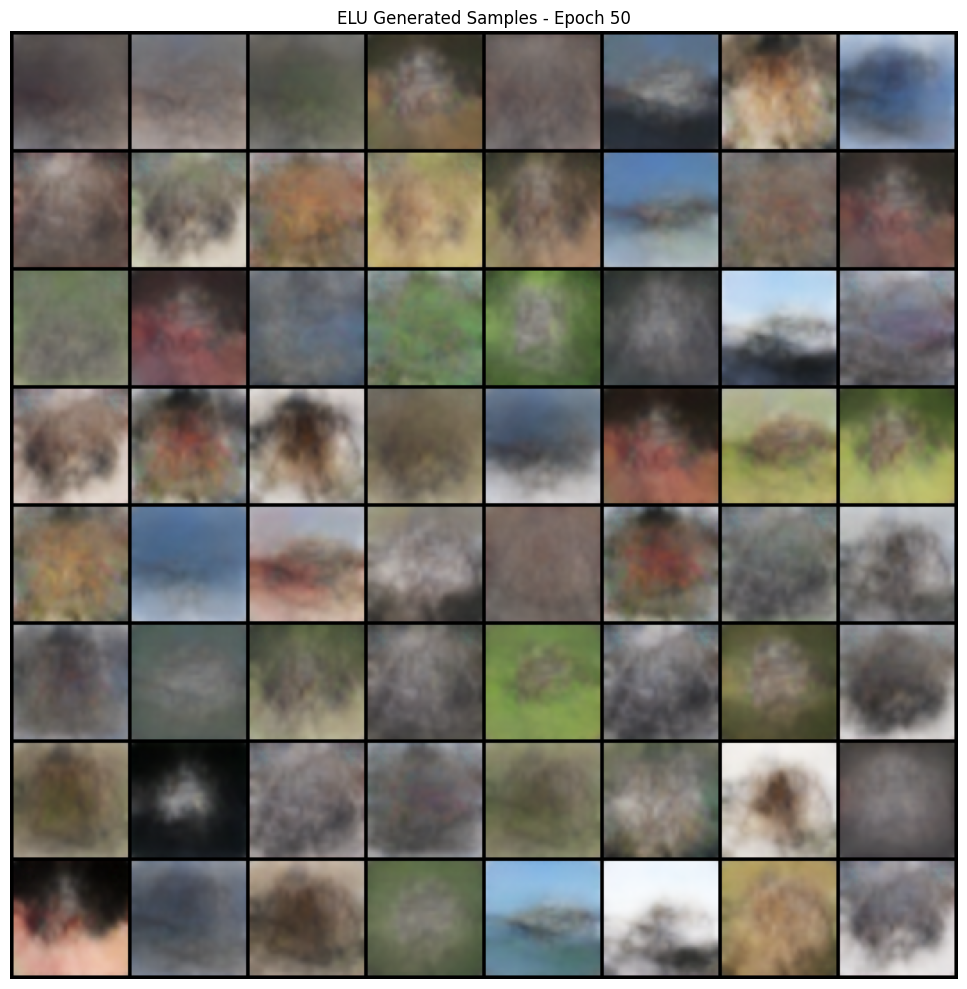


ELU training completed in 1474.1 seconds (24.6 minutes)


In [18]:
def train_epoch_elu(epoch):
    G_elu.train()
    D.train()

    running_G_loss = 0.0
    running_D_loss = 0.0

    for real_batch, _ in tqdm(train_loader, desc=f"Epoch {epoch}", leave=False):
        batch_size = real_batch.size(0)
        real_batch = real_batch.to(device)

        optimizer_D_elu.zero_grad()

        d_real = D(real_batch)
        real_labels = torch.ones(batch_size, device=device)
        loss_d_real = criterion(d_real, real_labels)

        z = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
        fake_batch = G_elu(z).detach()
        d_fake = D(fake_batch)
        fake_labels = torch.zeros(batch_size, device=device)
        loss_d_fake = criterion(d_fake, fake_labels)

        loss_d = loss_d_real + loss_d_fake
        loss_d.backward()
        optimizer_D_elu.step()

        optimizer_G_elu.zero_grad()

        z = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
        fake_batch = G_elu(z)
        d_fake = D(fake_batch)
        loss_g = criterion(d_fake, real_labels)

        loss_g.backward()
        optimizer_G_elu.step()

        ema_G_elu.update()

        running_G_loss += loss_g.item()
        running_D_loss += loss_d.item()

    return running_G_loss / len(train_loader), running_D_loss / len(train_loader)

history_elu = {
    'G_loss': [],
    'D_loss': [],
    'epochs': []
}

plt.ion()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

print("Starting ELU training...")
start_time = time.time()

for epoch in range(1, num_epochs_exp + 1):
    g_loss, d_loss = train_epoch_elu(epoch)

    history_elu['G_loss'].append(g_loss)
    history_elu['D_loss'].append(d_loss)
    history_elu['epochs'].append(epoch)

    elapsed = time.time() - start_time
    print(f"Epoch {epoch:3d}/{num_epochs_exp} | G_loss: {g_loss:.4f} | D_loss: {d_loss:.4f} | Time: {elapsed:.1f}s")

    if epoch % 2 == 0:
        ax1.clear()
        ax1.plot(history_elu['epochs'], history_elu['G_loss'], 'b-', label='Generator (ELU)')
        ax1.plot(history_elu['epochs'], history_elu['D_loss'], 'r-', label='Discriminator')
        ax1.set_xlabel('Epoch')
        ax1.set_ylabel('Loss')
        ax1.set_title('ELU Training Loss')
        ax1.legend()
        ax1.grid(True)
        if epoch % 5 == 0:
            ax2.clear()
            ema_G_elu.apply_shadow()
            G_elu.eval()
            with torch.no_grad():
                sample = G_elu(fixed_noise[:16])
                grid = utils.make_grid(sample, nrow=4, padding=2, normalize=True)
                ax2.imshow(grid.cpu().permute(1, 2, 0))
                ax2.set_title(f'ELU Samples - Epoch {epoch}')
                ax2.axis('off')
            ema_G_elu.restore()

        plt.tight_layout()
        plt.pause(0.01)
    if epoch % 5 == 0:
      ema_G_elu.apply_shadow()
      G_elu.eval()
      with torch.no_grad():
          fake_samples = G_elu(fixed_noise)
          grid = utils.make_grid(fake_samples, nrow=8, padding=2, normalize=True)

          plt.figure(figsize=(10, 10))
          plt.imshow(grid.cpu().permute(1, 2, 0))
          plt.title(f"ELU Generated Samples - Epoch {epoch}")
          plt.axis('off')
          plt.tight_layout()
          plt.show()
      ema_G_elu.restore()

plt.ioff()
training_time_elu = time.time() - start_time
print(f"\nELU training completed in {training_time_elu:.1f} seconds ({training_time_elu/60:.1f} minutes)")

Evaluating ELU model...


Generating ELU samples:   0%|          | 0/79 [00:00<?, ?it/s]

ELU Inception Score: 2.749 ± 0.119


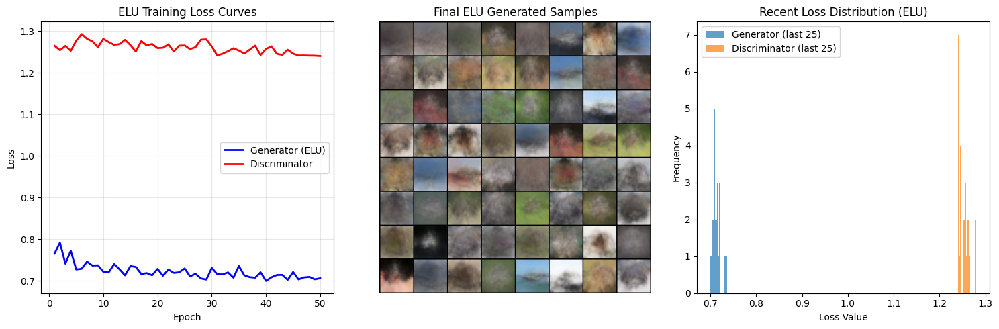

Generating diverse ELU sample set...


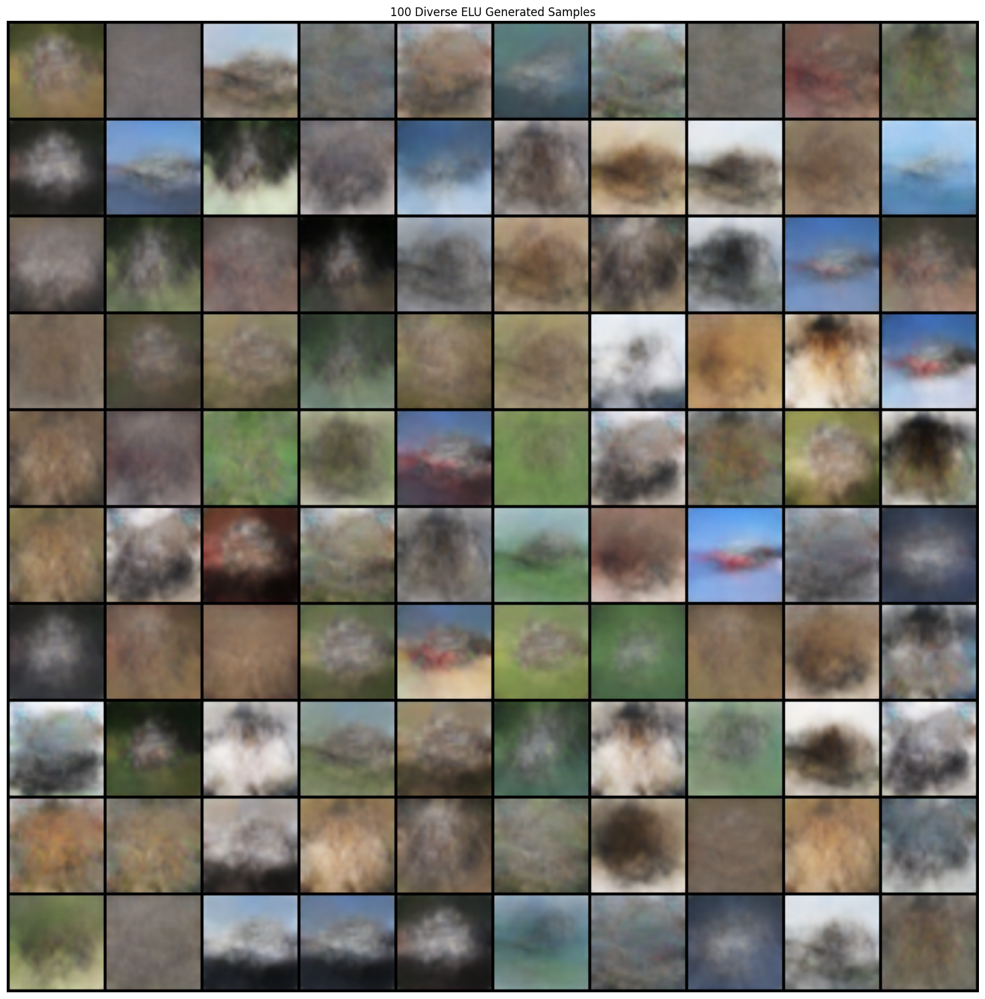

ELU EXPERIMENT COMPLETED
Total Training Time: 1474.1s (24.6 minutes)
Inception Score: 2.749 ± 0.119
Final Generator Loss: 0.7065
Final Discriminator Loss: 1.2398


In [19]:
print("Evaluating ELU model...")

ema_G_elu.apply_shadow() #fix ? 
G_elu.eval()

n_eval_samples = 5000
eval_samples_elu = []

with torch.no_grad():
    for i in tqdm(range(0, n_eval_samples, 64), desc="Generating ELU samples"):
        batch_size = min(64, n_eval_samples - i)
        z = torch.randn(batch_size, cfg["nz"], 1, 1, device=device)
        samples = G_elu(z)
        eval_samples_elu.append(samples.cpu())

eval_samples_elu = torch.cat(eval_samples_elu, 0)
eval_samples_elu = (eval_samples_elu + 1) / 2

is_metric = InceptionScore(splits=10, normalize=True)
is_mean_elu, is_std_elu = is_metric(eval_samples_elu)
print(f"ELU Inception Score: {is_mean_elu:.3f} ± {is_std_elu:.3f}")

#vis logging
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(history_elu['epochs'], history_elu['G_loss'], 'b-', linewidth=2, label='Generator (ELU)')
plt.plot(history_elu['epochs'], history_elu['D_loss'], 'r-', linewidth=2, label='Discriminator')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('ELU Training Loss Curves')
plt.legend()
plt.grid(True, alpha=0.3)

plt.subplot(1, 3, 2)
with torch.no_grad():
    final_samples_elu = G_elu(fixed_noise)
    grid = utils.make_grid(final_samples_elu, nrow=8, padding=2, normalize=True)
    plt.imshow(grid.cpu().permute(1, 2, 0))
    plt.title(f'Final ELU Generated Samples')
    plt.axis('off')

plt.subplot(1, 3, 3)
plt.hist(history_elu['G_loss'][-25:], alpha=0.7, label='Generator (last 25)', bins=15)
plt.hist(history_elu['D_loss'][-25:], alpha=0.7, label='Discriminator (last 25)', bins=15)
plt.xlabel('Loss Value')
plt.ylabel('Frequency')
plt.title('Recent Loss Distribution (ELU)')
plt.legend()

plt.tight_layout()
plt.savefig(f"{cfg['sample_dir']}/elu_results.png", dpi=300, bbox_inches='tight')
plt.show()

print("Generating diverse ELU sample set...")
with torch.no_grad():
    diverse_z = torch.randn(100, cfg["nz"], 1, 1, device=device)
    diverse_samples_elu = G_elu(diverse_z)
    diverse_grid = utils.make_grid(diverse_samples_elu, nrow=10, padding=2, normalize=True)

plt.figure(figsize=(15, 15))
plt.imshow(diverse_grid.cpu().permute(1, 2, 0))
plt.title('100 Diverse ELU Generated Samples')
plt.axis('off')
plt.tight_layout()
plt.savefig(f"{cfg['sample_dir']}/elu_diverse_samples.png", dpi=300, bbox_inches='tight')
plt.show()

ema_G_elu.restore()

print("="*60)
print("ELU EXPERIMENT COMPLETED")
print("="*60)
print(f"Total Training Time: {training_time_elu:.1f}s ({training_time_elu/60:.1f} minutes)")
print(f"Inception Score: {is_mean_elu:.3f} ± {is_std_elu:.3f}")
print(f"Final Generator Loss: {history_elu['G_loss'][-1]:.4f}")
print(f"Final Discriminator Loss: {history_elu['D_loss'][-1]:.4f}")
print("="*60)